In [1]:
import sys 
import os
import numpy as np
%matplotlib widget
import matplotlib as mpl
import matplotlib.pyplot as plt 
import matplotlib.colors as mcolors
import astropy.constants as c
import astropy.units as u
from astropy.io import fits
from IPython.display import display
import logging
from pathlib import Path
from datetime import datetime
import pyregion
from astropy.wcs import WCS
from astropy.visualization.wcsaxes import WCSAxes
from astropy.coordinates import SkyCoord
import importlib
import pickle
import pandas as pd
try:
    logging.getLogger('matplotlib').disabled = True
except:
    pass
import pandas as pd
pd.pandas.set_option('display.max_columns', None)
pd.pandas.set_option('display.max_rows', None)
import shutil
from astropy.table import QTable

In [2]:
ROOT_DIR = os.path.dirname(os.path.realpath('__file__'))
PROG_DIR = os.path.join(ROOT_DIR,'mirar')
os.chdir(PROG_DIR)

In [3]:
class Fits():
    def __init__(self,file):
        self.file = file
        self.data = {}
        self.header = {}
        open_file = fits.open(self.file)
        open_file.info()
        open_file.close()
        self.read()
        try:
            logging.getLogger('matplotlib').disabled = True
        except:
            pass
        
    def read(self,hdu=0):
        open_file = fits.open(self.file)
        try:
            self.data[hdu] = open_file[hdu].data.astype(float)
        except (AttributeError,TypeError,ValueError):
            print(fr"HDU {hdu} is not float")
            self.data[hdu] = open_file[hdu].data
            
        self.header[hdu] = open_file[hdu].header
        open_file.close()
        
    def wcs_plot(self,hdu=0):
        wcs = WCS(self.header[hdu])
        fig = plt.figure(clear=True)
        ax = plt.subplot(projection=wcs)
        fig.add_axes(ax)
        return fig, ax
    
    def create_copy(self):
        shutil.copy2(self.file,f"{self.file}.copy")
        
    def image(self,hdu=0,column=False,title=None,scale=[5,95],save=False,tag=None,wcs=False,median=True):
        data = self.data[hdu]
        if column:
            data = data[column]
        try:
            if median:
                img = np.nanmedian(data, axis=1)
            else:
                img = data
        except np.AxisError:
            print('invalid shape',data.shape)
            return
        if not wcs:
            fig, ax = plt.subplots()
            ax.set_xlabel('x pixel')
            ax.set_ylabel('y pixel')
        else:
            wcs_ = WCS(self.header[hdu])
            fig = plt.figure(clear=True)
            ax = plt.subplot(projection=wcs_)
            fig.add_axes(ax)
        if scale:
            self.scale_low, self.scale_high = np.percentile(img, scale)
            im = ax.imshow(data,cmap='magma',vmin=self.scale_low,vmax=self.scale_high)
        else:
            im = ax.imshow(data,cmap='magma')
        fig.colorbar(im,fraction=0.020, pad=0.04)
        if not title:
            title = fr"{os.path.basename(os.path.dirname(self.file))}/{os.path.basename(self.file)}"
        ax.set_title(title)
        if save:
            if tag:
                fig.savefig(os.path.join(os.path.dirname(self.file),rf"{os.path.basename(self.file)}_{tag}.png"),dpi=600)
            else:
                fig.savefig(os.path.join(os.path.dirname(self.file),rf"{os.path.basename(self.file)}.png"),dpi=600)
        fig.tight_layout()
        return ax
    
    def image_with_reg(self,reg,hdu=0,wcsaxis=[0.1,0.1,0.8,0.8],v=[0,100],save=False,tag=None):
        r = pyregion.open(reg).as_imagecoord(self.header[hdu])
        patch_list,artist_list=r.get_mpl_patches_texts()
        wcs = WCS(self.header[hdu])
        fig = plt.figure(clear=True)
        ax = plt.subplot(projection=wcs) 
        # ax = WCSAxes(fig,wcsaxis,wcs=wcs) 
        fig.add_axes(ax)
        for p in patch_list: 
            p.set_color('red')
            p.set_facecolor('none')
            ax.add_patch(p) 
        for t in artist_list: 
            ax.add_artist(t)
        
        if v:
            im = ax.imshow(self.data[0],origin="lower",vmin=v[0],vmax=v[1],cmap='magma')
        else:
            im = ax.imshow(self.data[0],origin="lower",cmap='magma')
        fig.colorbar(im,cmap='magma') 
        if save:
            if tag:
                fig.savefig(os.path.join(os.path.dirname(self.file),rf"{os.path.basename(self.file)}_{tag}.reg.png"),dpi=600)
            else:
                fig.savefig(os.path.join(os.path.dirname(self.file),rf"{os.path.basename(self.file)}.reg.png"),dpi=600)
        # fig.show()
        return ax

    def bin_table(self,hdu=0,return_=True,save=False):
        df = pd.DataFrame(self.data[hdu])
        if save:
            df.to_csv(os.path.join(os.path.dirname(self.file),rf"{os.path.basename(self.file)}.csv"),encoding='utf-8')
        if return_:
            return df
        else:
            return None
        

def src_table(file,save=False,return_=True):
    df = pd.read_pickle(file).get_data()
    if save:
        df.to_csv(os.path.join(os.path.dirname(file),rf"{os.path.basename(file)}.csv"),encoding='utf-8')
    if return_:
        return df
    else:
        return None
    
    
class Convert:
    
    def __init__(self,ra,dec):
        self.coords = SkyCoord(ra=ra*u.deg, dec=dec*u.deg)
        
    def get_coords(self):
        return self.coords
    
    def to_hms(self):
        return (self.coords.ra.hms,self.coords.dec.hms)

    def to_wcs(self):
        return (self.coords.ra.hms,self.coords.dec.dms)
    
def command(config,py=''):
    return rf"python{py} -m mirar -p {PIPELINE} -n {NIGHT} -c {config} -m"

def run(config,*args,**kwargs):
    os.system(command(config,*args,**kwargs))

def test(py=''):
    os.system(rf"python{py} -m unittest discover tests/")
    
output_files = {
    ''
}

def none_mask(lst):
    for i in range(len(lst)):
        if lst[i] == None:
            lst[i] = np.nan
    return lst

# General

In [ ]:
from mirar.pipelines import Pipeline

In [ ]:
print(sorted([x for x in Pipeline.pipelines.keys()]))

In [ ]:
os.system('python -m mirar wirc --help')

# Pipeline

In [4]:
TEST = 5
ENV = {
    # 'RAW_DATA_DIR': '/Users/astqx/Desktop/DREAMS/mirar_starterpack/',
    # 'OUTPUT_DATA_DIR': '/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/output_steps',
    # 'REF_IMG_DIR': '/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/ref',
    'RAW_DATA_DIR': f'/Users/astqx/Desktop/DREAMS/test/pipeline/test{TEST}',
    'OUTPUT_DATA_DIR': f'/Users/astqx/Desktop/DREAMS/test/pipeline/test{TEST}/wirc/output',
    'REF_IMG_DIR': f'/Users/astqx/Desktop/DREAMS/test/pipeline/test{TEST}/wirc/ref',
    'USE_WINTER_CACHE': 'false',
    'FRITZ_TOKEN': 'test',
    'KOWALSKI_TOKEN': 'test',
    'DB_USER': 'postgres',
    'DB_PWD': '',
}

PIPELINE = 'wirc'
# NIGHT = '20210330'
NIGHT = 'night'
NIGHT_SUB_DIR = os.path.join(ENV['RAW_DATA_DIR'],PIPELINE,NIGHT)
CAL_DIR = os.path.join(ENV['RAW_DATA_DIR'],PIPELINE,'cals')
CAL_TEST_DARK = os.path.join(CAL_DIR,'test_dark.fits')
CAL_TEST_FLAT = os.path.join(CAL_DIR,'test_flat.fits')
CAL_TEST_SKY  = os.path.join(CAL_DIR,'test_sky.fits')
CACHE_DIR = os.path.join(ENV['RAW_DATA_DIR'],PIPELINE,'cache')
LOG_FILE = os.path.join(ENV['RAW_DATA_DIR'],PIPELINE,'logs',f'pipeline_{datetime.now()}.log')

for var in ENV.keys():
    os.environ[var] = ENV[var]
display(os.system('printenv'))

# -- logging ---
logger = logging.getLogger(__name__)
logging.basicConfig(filename=LOG_FILE,level=logging.DEBUG)
logging.getLogger('matplotlib').disabled = True

# --- modules ---
# from mirar.catalog.kowalski import PS1, TMASS
from mirar.data import Dataset, ImageBatch
from mirar.catalog.vizier.ps1 import PS1XMatch
from mirar.catalog.vizier.tmass import TMASS
from mirar.catalog.vizier.sdss import SDSS
from mirar.catalog.vizier.skymapper import SkyMapper
from mirar.catalog.gaia import Gaia2Mass
from mirar.paths import (
    CAND_NAME_KEY,
    FITS_MASK_KEY,
    LATEST_SAVE_KEY,
    OBSCLASS_KEY,
    RAW_IMG_KEY,
    SATURATE_KEY,
)
from mirar.pipelines.wirc.generator import (
    wirc_astrometric_catalog_generator,
    wirc_photometric_catalog_generator,
    wirc_photometric_img_catalog_purifier,
    wirc_reference_image_generator,
    wirc_reference_image_resampler,
    wirc_reference_psfex,
    wirc_reference_sextractor,
    wirc_source_table_filter_annotator,
    wirc_zogy_catalogs_purifier,
)
from mirar.pipelines.wirc.load_wirc_image import load_raw_wirc_image
from mirar.pipelines.wirc.wirc_files import (
    prv_candidate_cols,
    psfex_path,
    scamp_fp_path,
    sextractor_astrometry_config,
    sextractor_candidate_config,
    sextractor_photometry_config,
    sextractor_reference_config,
    swarp_sp_path,
    wirc_avro_schema_path,
    wirc_mask_path,
)
from mirar.pipelines.wirc.wirc_files.models import (
    CANDIDATE_PREFIX,
    NAME_START,
    Candidate,
)
from mirar.processors.astromatic import Scamp, Sextractor, Swarp
from mirar.processors.astromatic.psfex import PSFex
from mirar.processors.astromatic.scamp.scamp import SCAMP_HEADER_KEY
from mirar.processors.astromatic.sextractor.sextractor import sextractor_checkimg_map
from mirar.processors.astromatic.swarp import ReloadSwarpComponentImages
from mirar.processors.astrometry.autoastrometry import AutoAstrometry
from mirar.processors.astrometry.utils import AstrometryFromFile
from mirar.processors.avro import IPACAvroExporter, SendToFritz
from mirar.processors.csvlog import CSVLog
from mirar.processors.dark import DarkCalibrator, MasterDarkCalibrator
from mirar.processors.database.database_inserter import DatabaseSourceInserter
from mirar.processors.database.database_selector import (
    CrossmatchSourceWithDatabase,
    DatabaseHistorySelector,
)
from mirar.processors.flat import SkyFlatCalibrator, MasterFlatCalibrator
from mirar.processors.mask import (
    MaskAboveThreshold,
    MaskPixelsFromPath,
    MaskPixelsFromPathInverted,
    MaskPixelsFromWCS,
    WriteMaskedCoordsToFile,
)
from mirar.processors.photcal import PhotCalibrator
from mirar.processors.photometry.aperture_photometry import (
    ImageAperturePhotometry,
    SourceAperturePhotometry,
)
from mirar.processors.photometry.psf_photometry import (
    ImagePSFPhotometry,
    SourcePSFPhotometry,
)
from mirar.processors.reference import ProcessReference
from mirar.processors.sky import NightSkyMedianCalibrator, MasterSkyCalibrator
from mirar.processors.sources import CandidateNamer, SourceWriter, ZOGYSourceDetector
from mirar.processors.sources.source_table_builder import ForcedPhotometryCandidateTable
from mirar.processors.sources.source_table_modifier import CustomSourceModifier
from mirar.processors.sources.utils import RegionsWriter
from mirar.processors.utils import (
    HeaderAnnotator,
    ImageBatcher,
    ImageDebatcher,
    ImageLoader,
    ImageSaver,
    ImageSelector,
)
from mirar.processors.utils.image_loader import LoadImageFromHeader
from mirar.processors.xmatch import XMatch
from mirar.processors.zogy.zogy import ZOGY, ZOGYPrepare

# --- blocks ---
from mirar.pipelines.wirc.blocks import (
    subtract,
    detect_candidates,
    package_candidates,
    log,
    masking,
    reduction,
)

# --- pipelines ---
from mirar.pipelines.wirc.wirc_pipeline import WircPipeline
from mirar.references import WIRCRef

# --- others ---
from mirar.data.cache import cache

cache.set_cache_dir(CACHE_DIR)


# -- configurations ---
reduction = [
    ImageSaver(output_dir_name="darkcal"),
    HeaderAnnotator(input_keys=LATEST_SAVE_KEY, output_key=RAW_IMG_KEY),
    ImageDebatcher(),
    ImageSelector((OBSCLASS_KEY, "science")),
    # ImageSelector(("object", "ZTF18aavqmki")),
    ImageBatcher(split_key=["filter", "object"]),
    SkyFlatCalibrator(),
    NightSkyMedianCalibrator(),
    AutoAstrometry(catalog="tmc"),
    Sextractor(output_sub_dir="postprocess", **sextractor_astrometry_config),
    Scamp(
        ref_catalog_generator=wirc_astrometric_catalog_generator,
        scamp_config_path=scamp_fp_path,
        cache=True,
    ),
    ImageSaver(output_dir_name="firstpass"),
    Swarp(swarp_config_path=swarp_sp_path, calculate_dims_in_swarp=True),
    ImageSaver(output_dir_name="firstpassstack"),
    # ImageSelector(("BASENAME", "image0125.fits_stack.fits")),
    Sextractor(
        output_sub_dir="firstpasssextractor",
        **sextractor_astrometry_config,
        checkimage_type="SEGMENTATION",
        cache=True,
    ),
    MaskPixelsFromPathInverted(
        mask_path_key=sextractor_checkimg_map["SEGMENTATION"],
        write_masked_pixels_to_file=True,
        output_dir="mask1",
    ),
    ImageSaver(output_dir_name="mask1", write_mask=True),
    MaskAboveThreshold(
        threshold_key=SATURATE_KEY, write_masked_pixels_to_file=True, output_dir="mask2"
    ),
    ImageSaver(output_dir_name="mask2", write_mask=True),
    WriteMaskedCoordsToFile(output_dir="mask_stack"),
    ReloadSwarpComponentImages(
        load_image=load_raw_wirc_image,
        copy_header_keys=FITS_MASK_KEY,
    ),
    LoadImageFromHeader(
        header_key=RAW_IMG_KEY,
        copy_header_keys=[SCAMP_HEADER_KEY, FITS_MASK_KEY],
        load_image=load_raw_wirc_image,
    ),
    AstrometryFromFile(astrometry_file_key=SCAMP_HEADER_KEY),
    ImageSaver(output_dir_name="firstpassastrom", write_mask=True),
    MaskPixelsFromWCS(
        write_masked_pixels_to_file=True,
        output_dir="mask_secondpass",
        only_write_mask=True,
    ),
    ImageSaver(output_dir_name="firstpassmasked", write_mask=True),
    SkyFlatCalibrator(flat_mask_key=FITS_MASK_KEY),
    NightSkyMedianCalibrator(flat_mask_key=FITS_MASK_KEY),
    Sextractor(output_sub_dir="postprocess", **sextractor_astrometry_config),
    Swarp(swarp_config_path=swarp_sp_path, calculate_dims_in_swarp=True),
    Sextractor(output_sub_dir="final_sextractor", **sextractor_photometry_config),
    PhotCalibrator(
        ref_catalog_generator=wirc_photometric_catalog_generator,
        image_photometric_catalog_purifier=wirc_photometric_img_catalog_purifier,
        write_regions=True,
    ),
    # RegionsWriter(output_dir_name="final"), # [!] added to save regions from photocal
    ImageSaver(output_dir_name="final"),
    # SourceWriter(output_dir_name="final"),
]

reduction_mastercal = [
    ImageSaver(output_dir_name="darkcal"),
    HeaderAnnotator(input_keys=LATEST_SAVE_KEY, output_key=RAW_IMG_KEY),
    ImageDebatcher(),
    ImageSelector((OBSCLASS_KEY, "science")),
    # ImageSelector(("object", "ZTF18aavqmki")),
    ImageBatcher(split_key=["filter", "object"]),
    MasterFlatCalibrator(master_image_path=CAL_TEST_FLAT),
    MasterSkyCalibrator(master_image_path=CAL_TEST_SKY),
    AutoAstrometry(catalog="tmc"),
    Sextractor(output_sub_dir="postprocess", **sextractor_astrometry_config),
    Scamp(
        ref_catalog_generator=wirc_astrometric_catalog_generator,
        scamp_config_path=scamp_fp_path,
        cache=True,
    ),
    ImageSaver(output_dir_name="firstpass"),
    Swarp(swarp_config_path=swarp_sp_path, calculate_dims_in_swarp=True),
    ImageSaver(output_dir_name="firstpassstack"),
    # ImageSelector(("BASENAME", "image0125.fits_stack.fits")),
    Sextractor(
        output_sub_dir="firstpasssextractor",
        **sextractor_astrometry_config,
        checkimage_type="SEGMENTATION",
        cache=True,
    ),
    MaskPixelsFromPathInverted(
        mask_path_key=sextractor_checkimg_map["SEGMENTATION"],
        write_masked_pixels_to_file=True,
        output_dir="mask1",
    ),
    ImageSaver(output_dir_name="mask1", write_mask=True),
    MaskAboveThreshold(
        threshold_key=SATURATE_KEY, write_masked_pixels_to_file=True, output_dir="mask2"
    ),
    ImageSaver(output_dir_name="mask2", write_mask=True),
    WriteMaskedCoordsToFile(output_dir="mask_stack"),
    ReloadSwarpComponentImages(
        load_image=load_raw_wirc_image,
        copy_header_keys=FITS_MASK_KEY,
    ),
    LoadImageFromHeader(
        header_key=RAW_IMG_KEY,
        copy_header_keys=[SCAMP_HEADER_KEY, FITS_MASK_KEY],
        load_image=load_raw_wirc_image,
    ),
    AstrometryFromFile(astrometry_file_key=SCAMP_HEADER_KEY),
    ImageSaver(output_dir_name="firstpassastrom", write_mask=True),
    MaskPixelsFromWCS(
        write_masked_pixels_to_file=True,
        output_dir="mask_secondpass",
        only_write_mask=True,
    ),
    ImageSaver(output_dir_name="firstpassmasked", write_mask=True),
    SkyFlatCalibrator(flat_mask_key=FITS_MASK_KEY),
    NightSkyMedianCalibrator(flat_mask_key=FITS_MASK_KEY),
    Sextractor(output_sub_dir="postprocess", **sextractor_astrometry_config),
    Swarp(swarp_config_path=swarp_sp_path, calculate_dims_in_swarp=True),
    Sextractor(output_sub_dir="final_sextractor", **sextractor_photometry_config),
    PhotCalibrator(
        ref_catalog_generator=wirc_photometric_catalog_generator,
        image_photometric_catalog_purifier=wirc_photometric_img_catalog_purifier,
        write_regions=True,
    ),
    # RegionsWriter(output_dir_name="final"), # [!] added to save regions from photocal
    ImageSaver(output_dir_name="final"),
    # SourceWriter(output_dir_name="final"),
]

image_photometry = [
    ImageAperturePhotometry(
        aper_diameters=[16],
        bkg_in_diameters=[25],
        bkg_out_diameters=[40],
        col_suffix_list=[""],
        phot_cutout_size=100,
        target_ra_key="TARGRA",
        target_dec_key="TARGDEC",
    ),
    Sextractor(**sextractor_reference_config, output_sub_dir="subtract", cache=False),
    PSFex(config_path=psfex_path, output_sub_dir="photometry", norm_fits=True),
    ImagePSFPhotometry(target_ra_key="TARGRA", target_dec_key="TARGDEC"),
    ImageSaver(output_dir_name="photometry"),
]

test_configuration = (
    [
        ImageLoader(
            input_img_dir=ENV['RAW_DATA_DIR'],
            input_sub_dir="raw",
            load_image=load_raw_wirc_image,
        )
    ]
    + log
    + masking
    + [ImageSelector(("exptime", "45.0")), MasterDarkCalibrator(master_image_path=CAL_TEST_DARK)]
    + reduction
)

test_configuration_mastercal = (
    [
        ImageLoader(
            input_img_dir=ENV['RAW_DATA_DIR'],
            input_sub_dir="raw",
            load_image=load_raw_wirc_image,
        )
    ]
    + log
    + masking
    + [ImageSelector(("exptime", "45.0")), MasterDarkCalibrator(master_image_path=CAL_TEST_DARK)]
    + reduction_mastercal
)

test_configuration_phot = (
    [
        ImageLoader(
            input_img_dir=ENV['RAW_DATA_DIR'],
            input_sub_dir="raw",
            load_image=load_raw_wirc_image,
        )
    ]
    + log
    + masking
    + [ImageSelector(("exptime", "45.0")), MasterDarkCalibrator(master_image_path=CAL_TEST_DARK)]
    + reduction
    + image_photometry
)

def reference_image_test_generator(
    header: fits.header,
    images_directory: str = ENV['REF_IMG_DIR'],
):
    """
    Function to generate reference image for testing
    Args:
        header: image header
        images_directory: reference image directory

    Returns:
        Reference Image
    """
    object_name = header["OBJECT"]
    filter_name = header["FILTER"]
    return WIRCRef(
        object_name=object_name,
        filter_name=filter_name,
        images_directory_path=images_directory,
    )


detect_candidates = [
    ZOGYSourceDetector(
        output_sub_dir="subtract",
        **sextractor_candidate_config,
        copy_image_keywords=["PROGID", "PROGPI"],
    ),
]

process_candidates = [
    RegionsWriter(output_dir_name="candidates"),
    SourcePSFPhotometry(),
    SourceAperturePhotometry(
        aper_diameters=[16, 70],
        phot_cutout_size=100,
        bkg_in_diameters=[25, 90],
        bkg_out_diameters=[40, 100],
        col_suffix_list=["", "big"],
        plot = True,
        plotfilename = 'aperture_phot'
    ),
    # SourceWriter(output_dir_name="candidates"),
    CustomSourceModifier(modifier_function=wirc_source_table_filter_annotator),
    # XMatch(catalog=TMASS(num_sources=3, search_radius_arcmin=0.5)),
    # XMatch(catalog=PS1(num_sources=3, search_radius_arcmin=0.5)),
    # XMatch(catalog=PS1(search_radius_arcmin=0.5, min_mag=100, max_mag=-100, filter_name='j')),
    XMatch(catalog=TMASS(num_sources=3, search_radius_arcmin=0.5, min_mag=0, max_mag=100, filter_name='J', columns=list(TMASS.column_names.keys()))),
    XMatch(catalog=PS1XMatch(num_sources=3, search_radius_arcmin=0.5, min_mag=0, max_mag=100, filter_name='g', columns=list(PS1XMatch.column_names.keys()))),
    # SourceWriter(output_dir_name="kowalski"),
    SourceWriter(output_dir_name="vizier"),
    CrossmatchSourceWithDatabase(
        db_table=Candidate,
        db_output_columns=[CAND_NAME_KEY],
        crossmatch_radius_arcsec=2.0,
        max_num_results=1,
    ),
    CandidateNamer(
        db_table=Candidate,
        base_name=CANDIDATE_PREFIX,
        name_start=NAME_START,
    ),
    DatabaseHistorySelector(
        crossmatch_radius_arcsec=2.0,
        time_field_name="jd",
        history_duration_days=500.0,
        db_table=Candidate,
        db_output_columns=[CAND_NAME_KEY] + prv_candidate_cols,
    ),
    DatabaseSourceInserter(db_table=Candidate, duplicate_protocol="fail"),
    SourceWriter(output_dir_name="candidates"),
    RegionsWriter(output_dir_name="candidates"), # [!] potential fix for inconsistency in region file - fixed by opening file in 'a' mode and not 'w'
    # EdgeCandidatesMask(edge_boundary_size=100),
    # FilterCandidates(),
]

subtract = [
    Sextractor(**sextractor_reference_config, output_sub_dir="subtract", cache=False),
    PSFex(config_path=psfex_path, output_sub_dir="subtract", norm_fits=True),
    ZOGYPrepare(output_sub_dir="subtract"),
    ZOGY(output_sub_dir="subtract", catalog_purifier=wirc_zogy_catalogs_purifier),
    ImageSaver(output_dir_name="diffs"),
]

candidates = detect_candidates + process_candidates  #+ package_candidates

test_imsub_configuration = (
    [
        ImageLoader(
            input_img_dir=ENV['RAW_DATA_DIR'],
            input_sub_dir="stack",
            load_image=load_raw_wirc_image,
        ),
        ProcessReference(
            ref_image_generator=reference_image_test_generator,
            swarp_resampler=wirc_reference_image_resampler,
            sextractor=wirc_reference_sextractor,
            ref_psfex=wirc_reference_psfex,
        ),
    ]
    + subtract
    + [ImageSaver(output_dir_name="subtract")]
    + candidates
)

test_imsub_reduced_configuration = (
    [
        ImageLoader(
            input_img_dir=ENV['RAW_DATA_DIR'],
            input_sub_dir="final",
            load_image=load_raw_wirc_image,
        ),
        ProcessReference(
            ref_image_generator=wirc_reference_image_generator,
            swarp_resampler=wirc_reference_image_resampler,
            sextractor=wirc_reference_sextractor,
            ref_psfex=wirc_reference_psfex,
        ),
    ]
    + subtract
    + [ImageSaver(output_dir_name="subtract")]
    + candidates
)

pipeline = WircPipeline(night=NIGHT)
pipeline.night_sub_dir = NIGHT_SUB_DIR
pipeline.add_configuration(configuration_name="test", configuration=test_configuration)
pipeline.add_configuration(configuration_name="test_mastercal", configuration=test_configuration_mastercal)
pipeline.add_configuration(configuration_name="test_phot", configuration=test_configuration_phot)
pipeline.add_configuration(configuration_name="test_imsub", configuration=test_imsub_configuration)
pipeline.add_configuration(configuration_name="test_imsub_reduced", configuration=test_imsub_reduced_configuration)
display(pipeline.all_pipeline_configurations)
# check id

MANPATH=/opt/local/share/man:/opt/homebrew/share/man::
VSCODE_CRASH_REPORTER_PROCESS_TYPE=extensionHost
TERM=xterm-color
SHELL=/bin/zsh
CLICOLOR=1
TMPDIR=/var/folders/n1/nl_dwlrx4v9_6j5wdwq5xnwh0000gn/T/
HOMEBREW_REPOSITORY=/opt/homebrew
FRITZ_TOKEN=test
CONDA_SHLVL=1
PYTHONUNBUFFERED=1
CONDA_PROMPT_MODIFIER=(mirar) 
USE_WINTER_CACHE=false
PATH_TO_FX=/Users/astqx/Desktop/admin/javafx-sdk-19.0.2.1/lib
ORIGINAL_XDG_CURRENT_DESKTOP=undefined
MallocNanoZone=0
PYDEVD_USE_FRAME_EVAL=NO
OUTPUT_DATA_DIR=/Users/astqx/Desktop/DREAMS/test/pipeline/test5/wirc/output
PYTHONIOENCODING=utf-8
USER=astqx
KOWALSKI_TOKEN=test
COMMAND_MODE=unix2003
CONDA_EXE=/Users/astqx/miniconda3/bin/conda
SSH_AUTH_SOCK=/private/tmp/com.apple.launchd.vdgVMcKqAa/Listeners
REF_IMG_DIR=/Users/astqx/Desktop/DREAMS/test/pipeline/test5/wirc/ref
__CF_USER_TEXT_ENCODING=0x1F5:0:15
PAGER=cat
ELECTRON_RUN_AS_NODE=1
VSCODE_AMD_ENTRYPOINT=vs/workbench/api/node/extensionHostProcess
_CE_CONDA=
LATEXWORKSHOP_DOCKER_LATEX=
CONDA_ROOT=/

0

Users/astqx/miniconda3
PATH=/Users/astqx/miniconda3/envs/mirar/bin:/Users/astqx/miniconda3/condabin:/opt/homebrew/opt/postgresql@16/bin:/opt/homebrew/bin:/Applications/MATLAB_R2022b.app/bin:/opt/homebrew/opt/openjdk@17/bin:/opt/homebrew/opt/llvm/bin:/opt/homebrew/opt/llvm/bin:/Applications/MATLAB_R2022b.app/bin:/opt/homebrew/opt/openjdk@17/bin:/opt/homebrew/opt/llvm/bin:/opt/homebrew/opt/llvm/bin:/Applications/MATLAB_R2022b.app/bin:/opt/homebrew/opt/openjdk@17/bin:/opt/homebrew/opt/llvm/bin:/opt/homebrew/opt/llvm/bin:/Applications/MATLAB_R2022b.app/bin:/opt/homebrew/opt/openjdk@17/bin:/opt/homebrew/opt/llvm/bin:/opt/homebrew/opt/llvm/bin:/Applications/MATLAB_R2022b.app/bin:/opt/homebrew/opt/openjdk@17/bin:/opt/homebrew/opt/llvm/bin:/opt/homebrew/opt/llvm/bin:/Users/astqx/miniconda3/condabin:/Applications/MATLAB_R2022b.app/bin:/opt/homebrew/opt/openjdk@17/bin:/opt/local/bin:/opt/local/sbin:/opt/homebrew/bin:/opt/homebrew/sbin:/usr/local/bin:/System/Cryptexes/App/usr/bin:/usr/bin:/bin:/u

{'default': [<mirar.processors.utils.image_loader.ImageLoader at 0x28bdde350>,
 'imsub': [<mirar.processors.utils.image_loader.ImageLoader at 0x28bdde350>,
 'test': [<mirar.processors.utils.image_loader.ImageLoader at 0x13155e8d0>,
 'test_mastercal': [<mirar.processors.utils.image_loader.ImageLoader at 0x28d485f50>,
 'test_phot': [<mirar.processors.utils.image_loader.ImageLoader at 0x28d4c1790>,
 'test_imsub': [<mirar.processors.utils.image_loader.ImageLoader at 0x28d4d9610>,
 'test_imsub_reduced': [<mirar.processors.utils.image_loader.ImageLoader at 0x28d4d9890>,
  <mirar.processors.sources.utils.regions_writer.RegionsWriter at 0x28d4d8c90>]}

In [ ]:
command = '\
    export RAW_DATA_DIR=/Users/astqx/Desktop/DREAMS/mirar_starterpack/ \n\
    export OUTPUT_DATA_DIR=/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/output \n\
    export REF_IMG_DIR=/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/ref/ZTF21aagppzg \n\
    python -m mirar -p wirc -n 20210330 -c test\
'
os.system(command)

## Candidates - old

Filename: /Users/astqx/Desktop/DREAMS/test/pipeline/test3/wirc/night/diffs/ZTF21aagppzg_J_stack_1_20210330.resamp.diff.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     196   (1805, 1631)   float64   


-0.0439284742002671

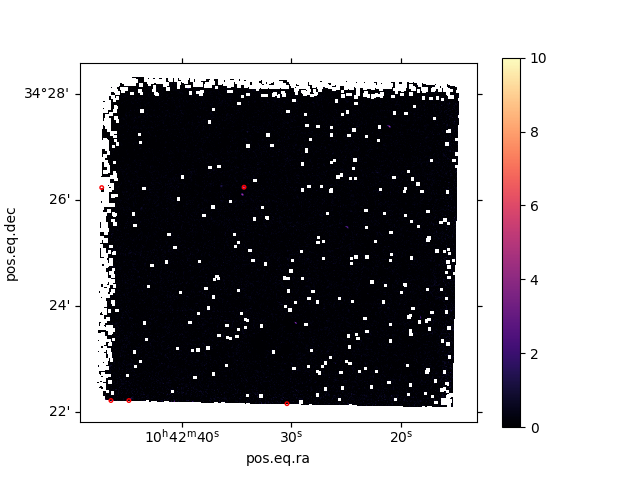

In [ ]:
reg = '/Users/astqx/Desktop/DREAMS/test/pipeline/test3/wirc/night/candidates/ZTF21aagppzg_J_stack_1_20210330.resamp.diff.reg'
resamp_diff = Fits('/Users/astqx/Desktop/DREAMS/test/pipeline/test3/wirc/night/diffs/ZTF21aagppzg_J_stack_1_20210330.resamp.diff.fits')
resamp_diff.image_with_reg(reg,v=[0,10],save=True)
resamp_diff.header[0]['SCORMEAN']

In [ ]:
coord = SkyCoord(ra=160.64*u.deg,dec=34.37*u.deg)
print('dec:',coord.dec.dms)
print('ra :',coord.ra.hms)

dec: dms_tuple(d=34.0, m=22.0, s=11.999999999990791)
ra : hms_tuple(h=10.0, m=42.0, s=33.60000000000653)


## Reduction

In [6]:
logger.debug(f"\n\n{datetime.now()}: Testing reduction\n\n")
pipeline.reduce_images(Dataset([ImageBatch()]), catch_all_errors=False, selected_configurations="test")

  0%|          | 0/1 [00:00<?, ?it/s]

100%|██████████| 7/7 [00:14<00:00,  2.06s/it]


  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


  0%|          | 0/1 [00:00<?, ?it/s]

(<mirar.data.base_data.Dataset at 0x2958c8410>,
 <mirar.errors.error_stack.ErrorStack at 0x171c39850>)

### Sources -old

Filename: /Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/final/image0092_stack.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     376   (2278, 2278)   float32   


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point

<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyr

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point

<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyr

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point

<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyr

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point

<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyr

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point

<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyr

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point

<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyr

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point

<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyr

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point

<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyr

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point

<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyr

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point

<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


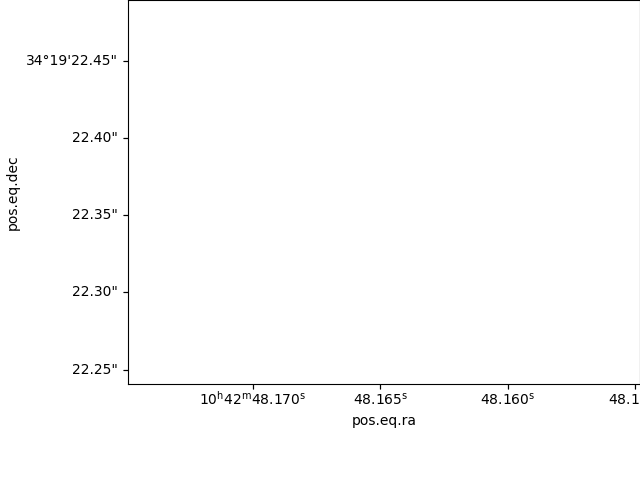

In [4]:
f = Fits('/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/final/image0092_stack.fits')
r = pyregion.open('/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/phot/image0092_stack.fitscleaned_img.reg').as_imagecoord(f.header[0])

patch_list,artist_list=r.get_mpl_patches_texts()
wcs = WCS(f.header[0])
fig = plt.figure(clear=True) 
ax = WCSAxes(fig,[0.2,0.2,0.8,0.8],wcs=wcs) 
fig.add_axes(ax)
for p in patch_list: 
    ax.add_patch(p) 
for t in artist_list: 
    ax.add_artist(t)

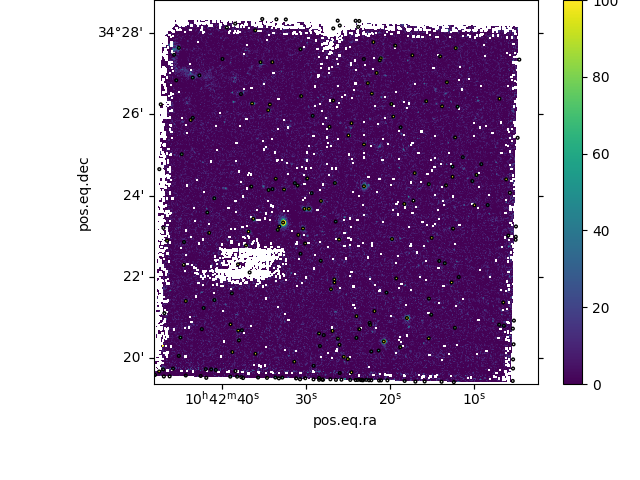

In [5]:
# nan_mask = ~np.isnan(f.data[0])
# print(list(f.data[0][nan_mask]))
# img = np.median(f.data[0], axis=1)
# print(img)
im = ax.imshow(f.data[0],origin="lower",vmin=0,vmax=100)
# im = ax.imshow(f.data[0],origin="lower")
fig.colorbar(im) 
plt.show()    
# plt.savefig('/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/phot/image0092_stack.fitscleaned_img.reg.png',dpi=600)

In [18]:
plt.savefig('/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/phot/image0092_stack.fitscleaned_img.reg.png',dpi=600)

### Final

Filename: /Users/astqx/Desktop/DREAMS/test/pipeline/test4/wirc/night/final/image0092_stack.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     376   (2278, 2278)   float32   


<Axes: title={'center': 'final/image0092_stack.fits'}, xlabel='x pixel', ylabel='y pixel'>

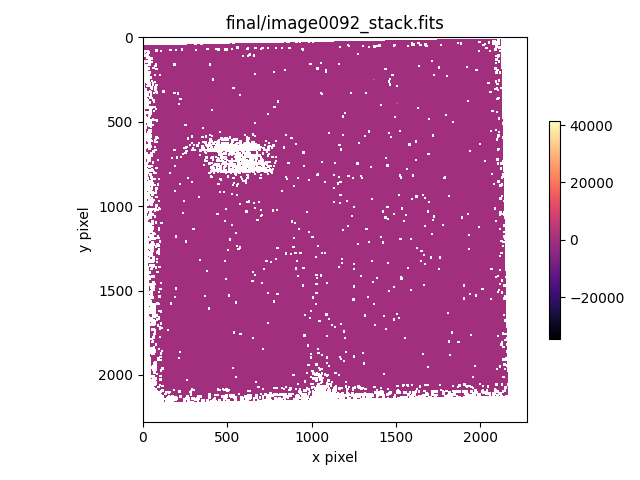

In [18]:
phot_final = Fits('/Users/astqx/Desktop/DREAMS/test/pipeline/test4/wirc/night/final/image0092_stack.fits')
phot_final.image(scale=False)

### Sources

Filename: /Users/astqx/Desktop/DREAMS/test/pipeline/test1/wirc/night/final/image0092_stack.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     376   (2278, 2278)   float32   


['wcs\n', 'CIRCLE(160.5847571783324,34.324340189544216,0.0005555555555555556)\n', 'CIRCLE(160.58789579549952,34.32432518672761,0.0005555555555555556)\n', 'CIRCLE(160.5888825585971,34.32428240939356,0.0005555555555555556)\n', 'CIRCLE(160.52256049168162,34.3240573076486,0.0005555555555555556)\n', 'CIRCLE(160.57620288469155,34.324092978279815,0.0005555555555555556)\n', 'CIRCLE(160.56626661404633,34.32386363893108,0.0005555555555555556)\n', 'CIRCLE(160.5708677008228,34.32380489488021,0.0005555555555555556)\n', 'CIRCLE(160.55787831481825,34.32375856404822,0.0005555555555555556)\n', 'CIRCLE(160.55179043236237,34.323607492563454,0.0005555555555555556)\n', 'CIRCLE(160.59733836926807,34.32439923021381,0.0005555555555555556)\n', 'CIRCLE(160.59386784282313,34.32438574241946,0.0005555555555555556)\n', 'CIRCLE(160.59680626092754,34.324389585354616,0.0005555555555555556)\n', 'CIRCLE(160.59273094973653,34.324375406225236,0.0005555555555555556)\n', 'CIRCLE(160.59804463426875,34.324468423439484,0.00055

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point

<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyr

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point

<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyr

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point

<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyr

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS key

<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS key

<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyr

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point

<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyr

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS key

<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyr

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point

<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyr

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyr

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point

<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyr

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point

<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyr

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS key

<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyr

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS key

<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyr

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS key

<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyr

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point

<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyregion.region_numbers.Distance'>
<class 'pyregion.region_numbers.CoordOdd'>
<class 'pyr

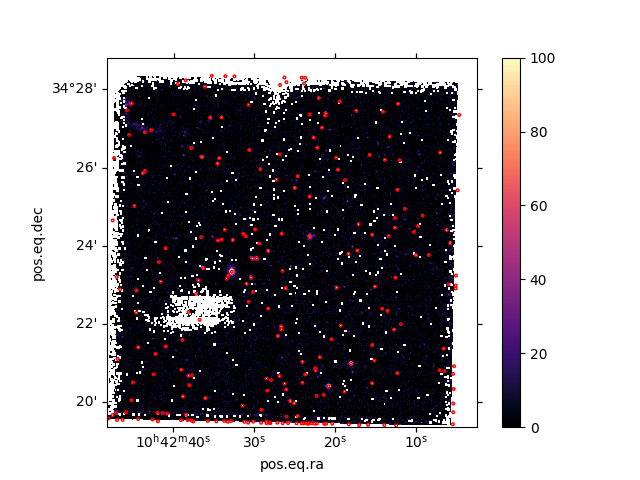

In [11]:
phot_final = Fits('/Users/astqx/Desktop/DREAMS/test/pipeline/test1/wirc/night/final/image0092_stack.fits')
reg = '/Users/astqx/Desktop/DREAMS/test/pipeline/test1/wirc/night/phot/image0092_stack.fitscleaned_img.reg'

# update frame based on RADECSYS header [!deprecated, update RADESYSa]
with open(reg,'r') as reg_file:
    reg_data = reg_file.readlines()
    print(reg_data)
frame = phot_final.header[0]['RADECSYS']
if reg_data[0] == 'wcs\n':
    reg_data[0] = reg_data[0].replace('wcs\n',f"{frame}\n")
    reg_new = f"{reg}.{frame}.reg"
    with open(reg_new,'w') as reg_file:
        reg_file.writelines(reg_data)
    phot_final.image_with_reg(reg_new,v=[0,100],save=True)
else:
    phot_final.image_with_reg(reg,v=[0,10],save=True)

# Reduction with master flat and sky calibration

In [6]:
logger.debug(f"\n\n{datetime.now()}: Testing reduction with mastercal\n\n")
pipeline.reduce_images(Dataset([ImageBatch()]), catch_all_errors=False, selected_configurations="test_mastercal")

  0%|          | 0/1 [00:00<?, ?it/s]

100%|██████████| 7/7 [00:00<00:00, 41.60it/s]


  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


  0%|          | 0/1 [00:00<?, ?it/s]

(<mirar.data.base_data.Dataset at 0x171c0b9d0>,
 <mirar.errors.error_stack.ErrorStack at 0x169c078d0>)

# Reduction with photometry

In [6]:
logger.debug(f"\n\n{datetime.now()}: Testing reduction with photometry\n\n")
pipeline.reduce_images(Dataset([ImageBatch()]), catch_all_errors=False, selected_configurations="test_phot")

  0%|          | 0/1 [00:00<?, ?it/s]

100%|██████████| 7/7 [00:00<00:00, 30.74it/s]


  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

KeyError: "Keyword 'TARGRA' not found."

Filename: /Users/astqx/Desktop/DREAMS/test/pipeline/test4/wirc/night/final/image0092_stack.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     376   (2278, 2278)   float32   


{0: SIMPLE  =                    T / This is a FITS file                            
 BITPIX  =                  -32 /                                                
 NAXIS   =                    2 /                                                
 NAXIS1  =                 2278 / NUMBER OF ELEMENTS ALONG THIS AXIS             
 NAXIS2  =                 2278 / NUMBER OF ELEMENTS ALONG THIS AXIS             
 EXTEND  =                    T / This file may contain FITS extensions          
 EQUINOX =        2000.00000000 / Mean equinox                                   
 MJD-OBS =       59303.36369039 / Modified Julian date at start                  
 RADESYS = 'ICRS    '           / Astrometric system                             
 CTYPE1  = 'RA---TAN'           / WCS projection type for this axis              
 CUNIT1  = 'deg     '           / Axis unit                                      
 CRVAL1  =   1.606102232445E+02 / World coordinate on this axis                  
 CRPIX1  =   

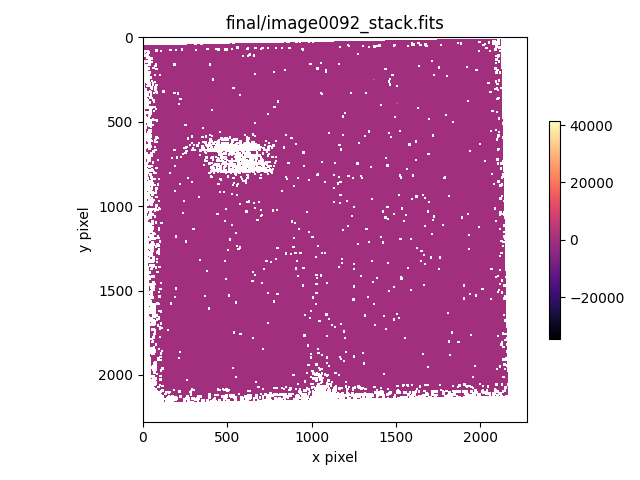

In [16]:
final_phot = Fits('/Users/astqx/Desktop/DREAMS/test/pipeline/test4/wirc/night/final/image0092_stack.fits')
final_phot.image(scale=False)
final_phot.header

# Image subtraction

In [6]:
logger.debug(f"\n\n{datetime.now()}: Testing image subtraction\n\n")
res, _ = pipeline.reduce_images(Dataset([ImageBatch()]), catch_all_errors=False, selected_configurations="test_imsub")

  0%|          | 0/1 [00:00<?, ?it/s]

100%|██████████| 1/1 [00:19<00:00, 19.75s/it]


  0%|          | 0/1 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [7]:
candidates_table = res[0][0].get_data()
pd.set_option('display.max_columns', None)
display(candidates_table)

,NUMBER,FLUX_APER,FLUXERR_APER,FLUX_AUTO,FLUXERR_AUTO,FLUX_RADIUS,FLUX_MAX,X_IMAGE,Y_IMAGE,XPEAK_IMAGE,YPEAK_IMAGE,ERRX2_IMAGE,ERRY2_IMAGE,ALPHA_J2000,DELTA_J2000,A_IMAGE,B_IMAGE,ELONGATION,FWHM_IMAGE,FWHM_WORLD,FLAGS,NAXIS1,NAXIS2,xpos,ypos,xpeak,ypeak,ra,dec,fwhm,aimage,bimage,aimagerat,bimagerat,elong,scorr,cutoutScience,cutoutTemplate,cutoutDifference,ZP,ZPSTD,DIFFPATH,SCIPATH,REFPATH,NPSFCAT,SAVEPATH,UNCPATH,jd,exptime,MAGLIM,FILTER,isdiffpos,progid,progpi,X_SHAPE,Y_SHAPE,psfflux,psffluxunc,chipsf,xshift,yshift,magpsf,sigmapsf,fluxap,fluxucap,magap,sigmagap,fluxapbig,fluxucapbig,magapbig,sigmagapbig,sciimgname,refimgname,diffimgname,fid,programid,programpi,diffmaglim,tmobjectid1,tmobjectid2,tmobjectid3,tmra1,tmra2,tmra3,tmdec1,tmdec2,tmdec3,tmjmag1,tmjmag2,tmjmag3,tmjmagerr1,tmjmagerr2,tmjmagerr3,tmhmag1,tmhmag2,tmhmag3,tmhmagerr1,tmhmagerr2,tmhmagerr3,tmkmag1,tmkmag2,tmkmag3,tmkmagerr1,tmkmagerr2,tmkmagerr3,tmph_qual1,tmph_qual2,tmph_qual3,nmtchtm,psobjectid1,psobjectid2,psobjectid3,psra1,psra2,psra3,psdec1,psdec2,psdec3,sgmag1,sgmag2,sgmag3,srmag1,srmag2,srmag3,simag1,simag2,simag3,szmag1,szmag2,szmag3,nmtchps1,psra4,psdec4,psobjectid4,sgmag4,srmag4,simag4,szmag4,psra5,psdec5,psobjectid5,sgmag5,srmag5,simag5,szmag5,psra6,psdec6,psobjectid6,sgmag6,srmag6,simag6,szmag6,psra7,psdec7,psobjectid7,sgmag7,srmag7,simag7,szmag7,psra8,psdec8,psobjectid8,sgmag8,srmag8,simag8,szmag8,psra9,psdec9,psobjectid9,sgmag9,srmag9,simag9,szmag9,psra10,psdec10,psobjectid10,sgmag10,srmag10,simag10,szmag10,psra11,psdec11,psobjectid11,sgmag11,srmag11,simag11,szmag11,psra12,psdec12,psobjectid12,sgmag12,srmag12,simag12,szmag12,xmatch,objectid,prv_candidates,candid
0,1,0.844406,2.265321,70.266762,21.055063,4.283644,4.569578,942.061890,82.357483,942,82,0.001315,0.005513,160.626684,34.369412,1.624528,0.787590,2.062658,0.000000,0.000000,1,1805,1631,941.061890,81.357483,941,81,160.626684,34.369412,0.000000,1.624528,0.787590,inf,inf,2.062658,7.696208,b'\x1f\x8b\x08\x00\xe3\xd3we\x02\xff\xec\xb7iT...,b'\x1f\x8b\x08\x00\xe3\xd3we\x02\xff\xed\xd7iT...,b'\x1f\x8b\x08\x00\xe3\xd3we\x02\xff\xec\xd8i4...,24.362,0.047,/Users/astqx/Desktop/DREAMS/test/pipeline/test...,/Users/astqx/Desktop/DREAMS/test/pipeline/test...,/Users/astqx/Desktop/DREAMS/test/pipeline/test...,/Users/astqx/Desktop/DREAMS/test/pipeline/test...,/Users/astqx/Desktop/DREAMS/test/pipeline/test...,/Users/astqx/Desktop/DREAMS/test/pipeline/test...,2459303.86369,315.0,19.764445,J,True,0,Kasliwal,1631,1805,85.492985,13.332151,2.455313,12,14,19.532174,0.175756,38.732959,23.185403,20.391798,0.651772,614.652982,90.281291,17.390425,0.166294,/Users/astqx/Desktop/DREAMS/test/pipeline/test...,/Users/astqx/Desktop/DREAMS/test/pipeline/test...,/Users/astqx/Desktop/DREAMS/test/pipeline/test...,1,0,Kasliwal,19.764445,nan,nan,nan,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,nan,nan,nan,0,149241606178168576.0,None,None,160.617806,None,None,34.373311,None,None,22.0314,None,None,21.1665,None,None,20.4895,None,None,20.1762,None,None,1,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,[{'objectid': 'WIRC21aaaaa'}],WIRC21aaaaa,[],78
1,4,-2.823674,2.292251,-2.801173,19.932997,0.483321,11.404209,141.138702,96.667633,142,97,0.00424,0.003515,160.69373,34.370384,1.611673,0.710227,2.269235,6.384245,0.000826,1,1805,1631,140.138702,95.667633,141,96,160.69373,34.370384,6.384245,1.611673,0.710227,0.252445,0.111247,2.269235,7.418827,b'\x1f\x8b\x08\x00\xe3\xd3we\x02\xff\xec\xbayT...,b'\x1f\x8b\x08\x00\xe3\xd3we\x02\xff\xed\x9byX...,b'\x1f\x8b\x08\x00\xe3\xd3we\x02\xff\xec\xdai4...,24.362,0.047,/Users/astqx/Desktop/DREAMS/test/pipeline/test...,/Users/astqx/Desktop/DREAMS/test/pipeline/test...,/U

### Resampled data

#### Stuff

Filename: /Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/subtract/ZTF21aagppzg_J_stack_1_20210330_ref.resamp.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     241   (1805, 1631)   float32   


<Axes: title={'center': 'subtract/ZTF21aagppzg_J_stack_1_20210330_ref.resamp.fits'}, xlabel='x pixel', ylabel='y pixel'>

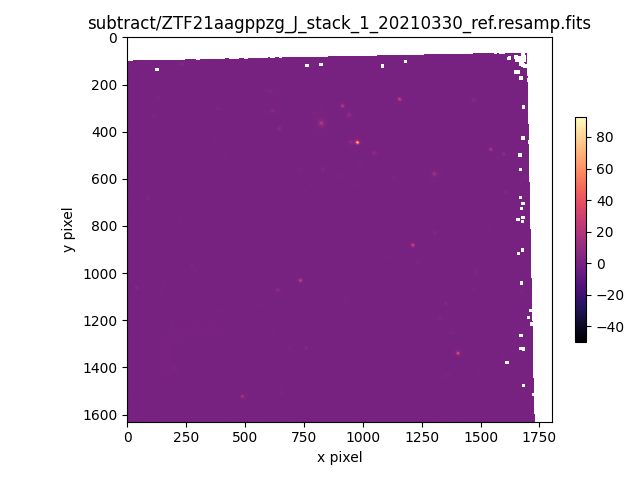

In [28]:
ref_resamp = Fits('/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/subtract/ZTF21aagppzg_J_stack_1_20210330_ref.resamp.fits')
ref_resamp.image(scale=False,save=True)

Filename: /Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/subtract/ZTF21aagppzg_J_stack_1_20210330_ref.resamp.fits.unc.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     241   (1805, 1631)   float32   


<Axes: title={'center': 'subtract/ZTF21aagppzg_J_stack_1_20210330_ref.resamp.fits.unc.fits'}, xlabel='x pixel', ylabel='y pixel'>

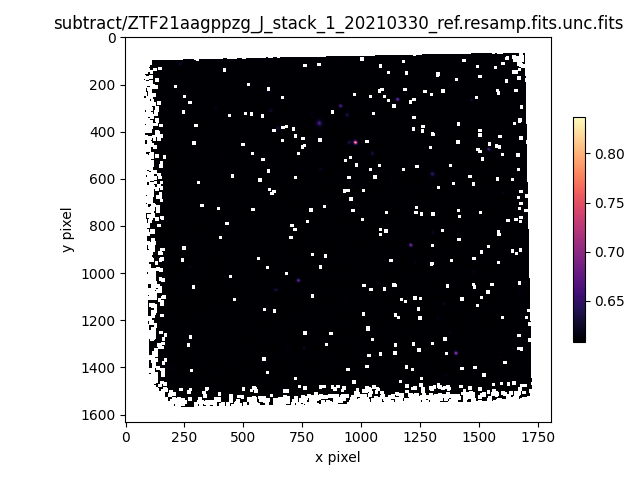

In [29]:
ref_resamp_unc = Fits('/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/subtract/ZTF21aagppzg_J_stack_1_20210330_ref.resamp.fits.unc.fits')
ref_resamp_unc.image(scale=False,save=True)

Filename: /Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/subtract/ZTF21aagppzg_J_stack_1_20210330_ref.resamp.scaled.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     243   (1805, 1631)   float32   


<Axes: title={'center': 'subtract/ZTF21aagppzg_J_stack_1_20210330_ref.resamp.scaled.fits'}, xlabel='x pixel', ylabel='y pixel'>

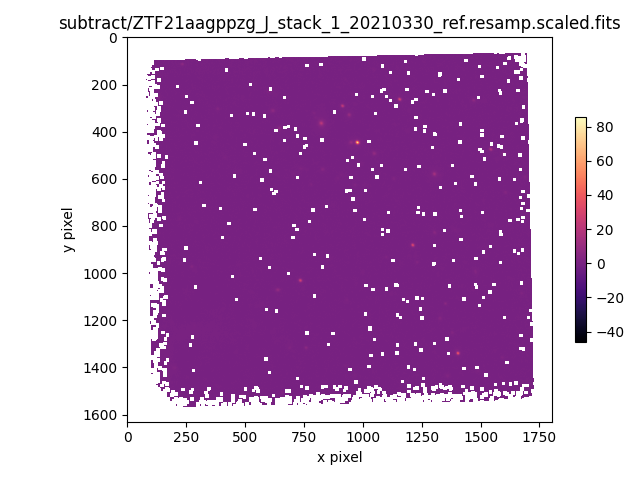

In [30]:
ref_resamp_scaled = Fits('/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/subtract/ZTF21aagppzg_J_stack_1_20210330_ref.resamp.scaled.fits')
ref_resamp_scaled.image(scale=False,save=True)

#### PSF model

Filename: /Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/subtract/ZTF21aagppzg_J_stack_1_20210330_ref.resamp.psfmodel
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU       6   (41, 41)   float32   


<Axes: title={'center': 'subtract/ZTF21aagppzg_J_stack_1_20210330_ref.resamp.psfmodel'}, xlabel='x pixel', ylabel='y pixel'>

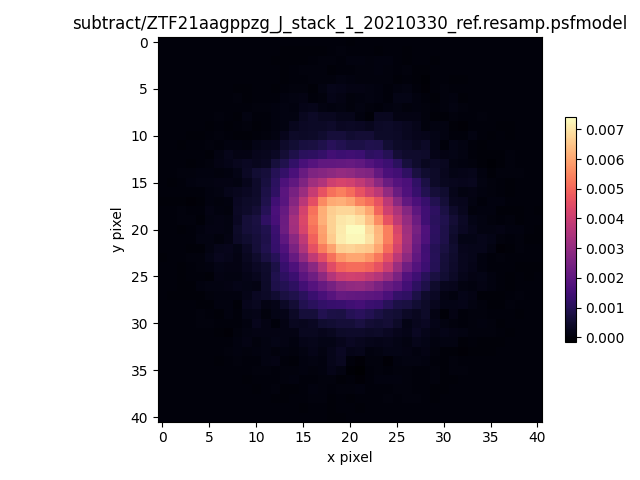

In [31]:
ref_resamp_psfmodel = Fits('/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/subtract/ZTF21aagppzg_J_stack_1_20210330_ref.resamp.psfmodel')
ref_resamp_psfmodel.image(scale=False,save=True)

In [27]:
ref_resamp_psf = Fits('/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/subtract/ZTF21aagppzg_J_stack_1_20210330_ref.resamp.psf')
ref_resamp_psf.image(scale=False)

Filename: /Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/subtract/ZTF21aagppzg_J_stack_1_20210330_ref.resamp.psf
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU       4   ()      
  1  PSF_DATA      1 BinTableHDU     32   1R x 1C   [16810E]   
HDU 0 is not float


AttributeError: 'NoneType' object has no attribute 'shape'

Filename: /Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/subtract/ZTF21aagppzg_J_stack_1_20210330.resamp.psfmodel
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU       6   (41, 41)   float32   


<Axes: title={'center': 'subtract/ZTF21aagppzg_J_stack_1_20210330.resamp.psfmodel'}, xlabel='x pixel', ylabel='y pixel'>

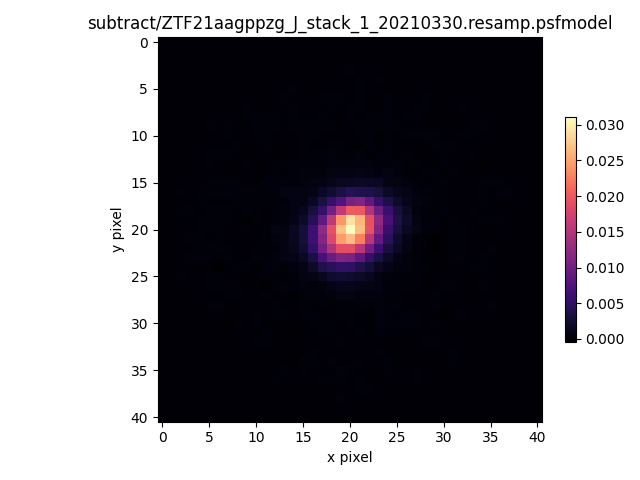

In [34]:
resamp_psfmodel = Fits('/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/subtract/ZTF21aagppzg_J_stack_1_20210330.resamp.psfmodel')
resamp_psfmodel.image(scale=False,save=True)

### Diff

Filename: /Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/subtract/ZTF21aagppzg_J_stack_1_20210330.resamp.diff.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     196   (1805, 1631)   float64   


<Axes: title={'center': 'subtract/ZTF21aagppzg_J_stack_1_20210330.resamp.diff.fits'}, xlabel='x pixel', ylabel='y pixel'>

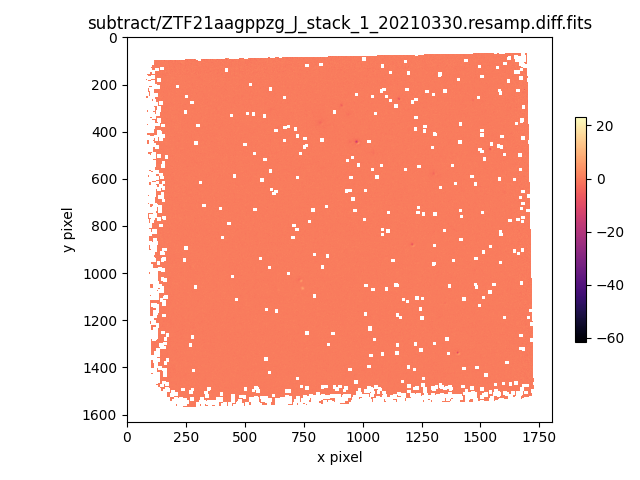

In [54]:
resamp_diff = Fits('/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/subtract/ZTF21aagppzg_J_stack_1_20210330.resamp.diff.fits')
resamp_diff.image(scale=False,save=True)

Filename: /Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/diffs/ZTF21aagppzg_J_stack_1_20210330.resamp.diff.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     196   (1805, 1631)   float64   


<Axes: title={'center': 'diffs/ZTF21aagppzg_J_stack_1_20210330.resamp.diff.fits'}, xlabel='x pixel', ylabel='y pixel'>

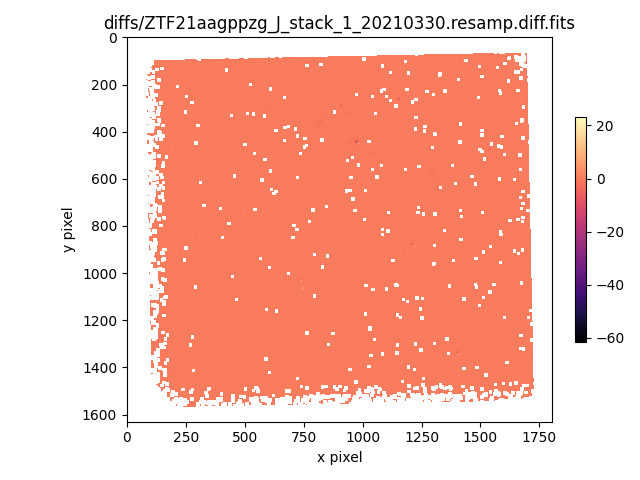

In [36]:
resamp_diff_diffs = Fits('/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/diffs/ZTF21aagppzg_J_stack_1_20210330.resamp.diff.fits')
resamp_diff_diffs.image(scale=False,save=True)

### Good sources

In [13]:
reg = '/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/subtract/ZTF21aagppzg_J_stack_1_20210330.resamp.cat.goodsources.reg'
resamp = Fits('/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/subtract/ZTF21aagppzg_J_stack_1_20210330.resamp.fits')
resamp.image_with_reg(reg,v=[0,10],save=True)

Filename: /Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/subtract/ZTF21aagppzg_J_stack_1_20210330.resamp.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     180   (1805, 1631)   float32   


<WCSAxes: >

Filename: /Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/subtract/ZTF21aagppzg_J_stack_1_20210330_ref.resamp.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     241   (1805, 1631)   float32   


<WCSAxes: >

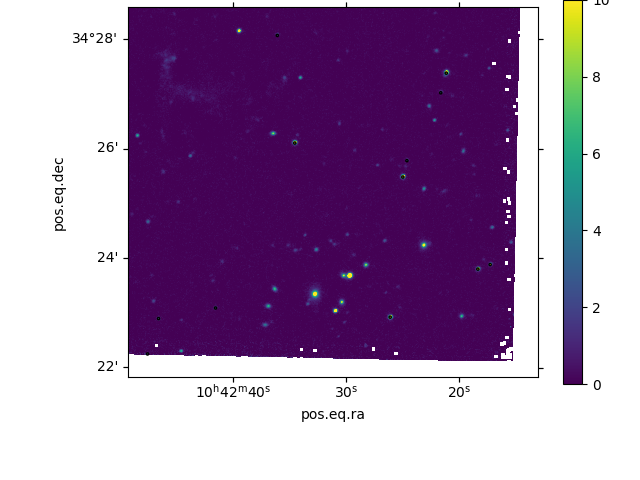

In [73]:
reg = '/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/subtract/ZTF21aagppzg_J_stack_1_20210330_ref.resamp.cat.goodsources.reg'
ref_resamp = Fits('/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/subtract/ZTF21aagppzg_J_stack_1_20210330_ref.resamp.fits')
ref_resamp.image_with_reg(reg,v=[0,10],save=True)

Filename: /Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/subtract/ZTF21aagppzg_J_stack_1_20210330.resamp.diff.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     196   (1805, 1631)   float64   


<WCSAxes: >

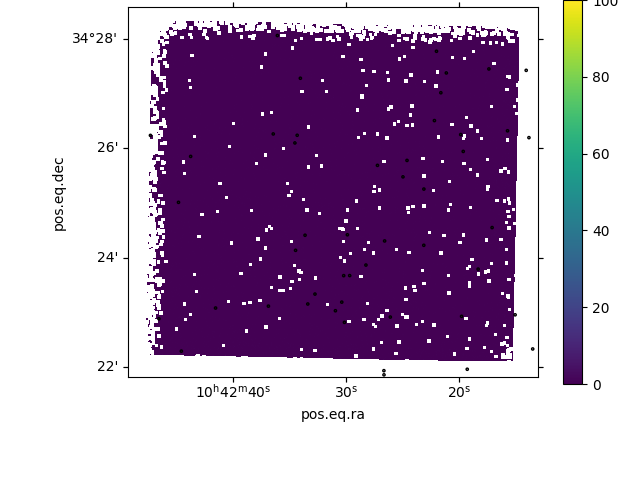

In [66]:
reg = '/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/subtract/ZTF21aagppzg_J_stack_1_20210330.resamp.cat.goodsources.reg'
resamp_diff = Fits('/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/subtract/ZTF21aagppzg_J_stack_1_20210330.resamp.diff.fits')
resamp_diff.image_with_reg(reg)

In [55]:
reg = '/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/subtract/ZTF21aagppzg_J_stack_1_20210330_ref.resamp.cat.goodsources.reg'
resamp_diff = Fits('/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/subtract/ZTF21aagppzg_J_stack_1_20210330.resamp.diff.fits')
resamp_diff.image_with_reg(reg)

Filename: /Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/subtract/ZTF21aagppzg_J_stack_1_20210330.resamp.diff.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     196   (1805, 1631)   float64   


<WCSAxes: >

### Candidates

Filename: /Users/astqx/Desktop/DREAMS/test/pipeline/test3/wirc/night/diffs/ZTF21aagppzg_J_stack_1_20210330.resamp.diff.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     196   (1805, 1631)   float64   


-0.0439284742002671

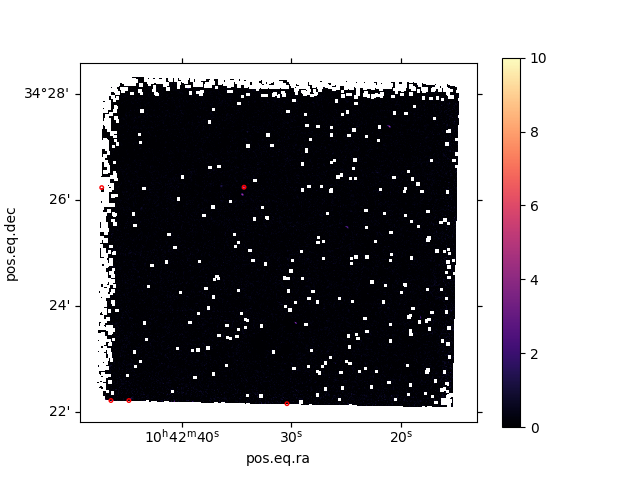

In [12]:
reg = '/Users/astqx/Desktop/DREAMS/test/pipeline/test3/wirc/night/candidates/ZTF21aagppzg_J_stack_1_20210330.resamp.diff.reg'
resamp_diff = Fits('/Users/astqx/Desktop/DREAMS/test/pipeline/test3/wirc/night/diffs/ZTF21aagppzg_J_stack_1_20210330.resamp.diff.fits')
resamp_diff.image_with_reg(reg,v=[0,10],save=True)
resamp_diff.header[0]['SCORMEAN']

In [155]:
coord = SkyCoord(ra=160.64*u.deg,dec=34.37*u.deg)
print('dec:',coord.dec.dms)
print('ra :',coord.ra.hms)

dec: dms_tuple(d=34.0, m=22.0, s=11.999999999990791)
ra : hms_tuple(h=10.0, m=42.0, s=33.60000000000653)


# Image subtraction with reduced data

In [5]:
logger.debug(f"\n\n{datetime.now()}: Testing image subtraction with reduced data\n\n")
res, _ = pipeline.reduce_images(Dataset([ImageBatch()]), catch_all_errors=False, selected_configurations="test_imsub_reduced")

  0%|          | 0/1 [00:00<?, ?it/s]

100%|██████████| 1/1 [00:00<00:00, 31.74it/s]


  0%|          | 0/1 [00:00<?, ?it/s]

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

/Users/astqx/Desktop/DREAMS/mirar/mirar/processors/zogy/pyzogy.py:204: RuntimeWarning: invalid value encountered in sqrt
  s_corr = score / np.sqrt(new_noise + ref_noise + v_ast_s_n + v_ast_s_r)


  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

/Users/astqx/Desktop/DREAMS/mirar/mirar/processors/photometry/utils.py:319: RuntimeWarning: invalid value encountered in log10
  magnitudes = zeropoint_list - 2.5 * np.log10(flux_list)


  0%|          | 0/1 [00:00<?, ?it/s]

/Users/astqx/Desktop/DREAMS/mirar/mirar/processors/photometry/utils.py:319: RuntimeWarning: invalid value encountered in log10
  magnitudes = zeropoint_list - 2.5 * np.log10(flux_list)
/Users/astqx/Desktop/DREAMS/mirar/mirar/processors/photometry/utils.py:319: RuntimeWarning: invalid value encountered in log10
  magnitudes = zeropoint_list - 2.5 * np.log10(flux_list)


  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

/Users/astqx/miniconda3/envs/mirar/lib/python3.11/site-packages/pandas/core/internals/base.py:193: UserWarning: Warning: converting a masked element to nan.
  arr[indexer] = value


  0%|          | 0/1 [00:00<?, ?it/s]

/Users/astqx/miniconda3/envs/mirar/lib/python3.11/site-packages/pandas/core/internals/base.py:193: UserWarning: Warning: converting a masked element to nan.
  arr[indexer] = value
/Users/astqx/miniconda3/envs/mirar/lib/python3.11/site-packages/pandas/core/internals/base.py:193: UserWarning: Warning: converting a masked element to nan.
  arr[indexer] = value
/Users/astqx/miniconda3/envs/mirar/lib/python3.11/site-packages/pandas/core/dtypes/missing.py:604: UserWarning: Warning: converting a masked element to nan.
  val = np.array(val, copy=False)
/Users/astqx/miniconda3/envs/mirar/lib/python3.11/site-packages/pandas/core/internals/blocks.py:1067: UserWarning: Warning: converting a masked element to nan.
  values[indexer] = casted
/Users/astqx/miniconda3/envs/mirar/lib/python3.11/site-packages/pandas/core/dtypes/missing.py:604: UserWarning: Warning: converting a masked element to nan.
  val = np.array(val, copy=False)
/Users/astqx/miniconda3/envs/mirar/lib/python3.11/site-packages/pandas/

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

In [9]:
candidates_table = res[0][0].get_data()
pd.set_option('display.max_columns', None)
display(candidates_table)

,NUMBER,FLUX_APER,FLUXERR_APER,FLUX_AUTO,FLUXERR_AUTO,FLUX_RADIUS,FLUX_MAX,X_IMAGE,Y_IMAGE,XPEAK_IMAGE,YPEAK_IMAGE,ERRX2_IMAGE,ERRY2_IMAGE,ALPHA_J2000,DELTA_J2000,A_IMAGE,B_IMAGE,ELONGATION,FWHM_IMAGE,FWHM_WORLD,FLAGS,NAXIS1,NAXIS2,xpos,ypos,xpeak,ypeak,ra,dec,fwhm,aimage,bimage,aimagerat,bimagerat,elong,scorr,cutoutScience,cutoutTemplate,cutoutDifference,ZP,ZPSTD,DIFFPATH,SCIPATH,REFPATH,NPSFCAT,SAVEPATH,UNCPATH,jd,exptime,MAGLIM,FILTER,isdiffpos,progid,progpi,X_SHAPE,Y_SHAPE,psfflux,psffluxunc,chipsf,xshift,yshift,magpsf,sigmapsf,fluxap,fluxucap,magap,sigmagap,fluxapbig,fluxucapbig,magapbig,sigmagapbig,sciimgname,refimgname,diffimgname,fid,programid,programpi,diffmaglim,tmobjectid1,tmobjectid2,tmobjectid3,tmra1,tmra2,tmra3,tmdec1,tmdec2,tmdec3,tmjmag1,tmjmag2,tmjmag3,tmjmagerr1,tmjmagerr2,tmjmagerr3,tmhmag1,tmhmag2,tmhmag3,tmhmagerr1,tmhmagerr2,tmhmagerr3,tmkmag1,tmkmag2,tmkmag3,tmkmagerr1,tmkmagerr2,tmkmagerr3,tmph_qual1,tmph_qual2,tmph_qual3,nmtchtm,psobjectid1,psobjectid2,psobjectid3,psra1,psra2,psra3,psdec1,psdec2,psdec3,sgmag1,sgmag2,sgmag3,srmag1,srmag2,srmag3,simag1,simag2,simag3,szmag1,szmag2,szmag3,nmtchps1,psra4,psdec4,psobjectid4,sgmag4,srmag4,simag4,szmag4,psra5,psdec5,psobjectid5,sgmag5,srmag5,simag5,szmag5,psra6,psdec6,psobjectid6,sgmag6,srmag6,simag6,szmag6,psra7,psdec7,psobjectid7,sgmag7,srmag7,simag7,szmag7,psra8,psdec8,psobjectid8,sgmag8,srmag8,simag8,szmag8,psra9,psdec9,psobjectid9,sgmag9,srmag9,simag9,szmag9,psra10,psdec10,psobjectid10,sgmag10,srmag10,simag10,szmag10,psra11,psdec11,psobjectid11,sgmag11,srmag11,simag11,szmag11,psra12,psdec12,psobjectid12,sgmag12,srmag12,simag12,szmag12,xmatch,objectid,prv_candidates,candid
0,1,126.980522,7.183130,2766.363037,39.002148,2.294501,283.769104,886.122314,81.360062,886,81,0.004598,0.01262,160.626797,34.369392,2.175604,1.115209,1.950849,9.324739,0.001207,1,1750,1684,885.122314,80.360062,885,80,160.626797,34.369392,9.324739,2.175604,1.115209,0.233315,0.119597,1.950849,8.115877,b'\x1f\x8b\x08\x00\xddl\x83e\x02\xff\xec\xbbiT...,b'\x1f\x8b\x08\x00\xddl\x83e\x02\xff\xed\xdayP...,b'\x1f\x8b\x08\x00\xddl\x83e\x02\xff\xec\xd7y4...,29.380098,0.099567,/Users/astqx/Desktop/DREAMS/test/pipeline/test...,/Users/astqx/Desktop/DREAMS/test/pipeline/test...,/Users/astqx/Desktop/DREAMS/test/pipeline/test...,/Users/astqx/Desktop/DREAMS/test/pipeline/test...,/Users/astqx/Desktop/DREAMS/test/pipeline/test...,/Users/astqx/Desktop/DREAMS/test/pipeline/test...,2459303.86369,315.0,20.72293,J,True,0,Kasliwal,1684,1750,4385.311303,586.36845,2.171196,14,15,20.275097,0.176068,1408.734247,1012.308745,21.508026,0.78672,37351.88318,3942.803052,17.949317,0.151839,/Users/astqx/Desktop/DREAMS/test/pipeline/test...,/Users/astqx/Desktop/DREAMS/test/pipeline/test...,/Users/astqx/Desktop/DREAMS/test/pipeline/test...,1,0,Kasliwal,20.72293,nan,nan,nan,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,nan,nan,nan,0,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,0,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,[{'objectid': 'WIRC21aaaaa'}],WIRC21aaaaa,[],116
1,2,-82.556526,2.133825,5596.835449,52.094543,3.367241,520.550598,167.980194,95.659599,168,94,0.009129,0.004859,160.6869,34.370366,1.801844,1.176134,1.532006,8.711145,0.001128,1,1750,1684,166.980194,94.659599,167,93,160.6869,34.370366,8.711145,1.801844,1.176134,0.206844,0.135015,1.532006,9.261156,b'\x1f\x8b\x08\x00\xddl\x83e\x02\xff\xec\xb7iT...,b'\x1f\x8b\x08\x00\xddl\x83e\x02\xff\xed\x9aWP...,b'\x1f\x8b\x08\x00\xddl\x83e\x02\xff\xec\xd8WP...,29.380098,0.099567,/Users/astqx/Desktop/DREAMS/test/pipeline/test...,/Users/astqx/Desktop/DREAMS/test/pipeline/test...,/Use

In [10]:
test = 5
reg = f'/Users/astqx/Desktop/DREAMS/test/pipeline/test{test}/wirc/night/candidates/image0092_stack.resamp.diff.reg'
resamp_diff = Fits(f'/Users/astqx/Desktop/DREAMS/test/pipeline/test{test}/wirc/night/diffs/image0092_stack.resamp.diff.fits')
resamp_diff.image_with_reg(reg,v=[0,10],save=True)
resamp_diff.header[0]['SCORMEAN']

Filename: /Users/astqx/Desktop/DREAMS/test/pipeline/test5/wirc/night/diffs/image0092_stack.resamp.diff.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     400   (1750, 1684)   float64   


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


-0.07065754214269347

Filename: /Users/astqx/Desktop/DREAMS/test/pipeline/test4/wirc/night/photometry/image0092_stack.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     376   (2278, 2278)   float32   


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


<WCSAxes: title={'center': 'photometry/image0092_stack.fits'}>

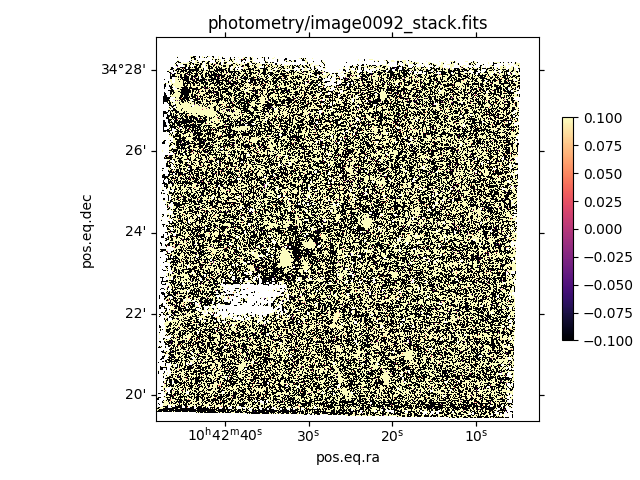

In [29]:
photometry_source = Fits('/Users/astqx/Desktop/DREAMS/test/pipeline/test4/wirc/night/photometry/image0092_stack.fits')
photometry_source.image(scale=[5,95],wcs=True,save=True)

Filename: /Users/astqx/Desktop/DREAMS/test/pipeline/test2/wirc/output/references/image0092_stack_ref.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     217   (2324, 2320)   float32   


<WCSAxes: title={'center': 'references/image0092_stack_ref.fits'}>

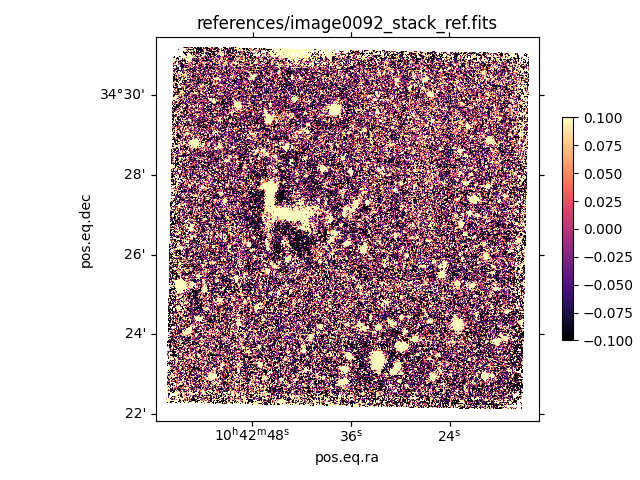

In [16]:
ref = Fits('/Users/astqx/Desktop/DREAMS/test/pipeline/test2/wirc/output/references/image0092_stack_ref.fits')
ref.image(scale=[5,95],wcs=True,save=True)

## Candidates

TODO
- check edge detections, validate psf?

In [17]:
# reduced data
candid_pkl = '/Users/astqx/Desktop/DREAMS/test/pipeline/test4/wirc/night/candidates/image0092_stack.resamp.diff_sources.pkl'
# given stack
# candid_pkl = '/Users/astqx/Desktop/DREAMS/test/pipeline/test3/wirc/night/candidates/ZTF21aagppzg_J_stack_1_20210330.resamp.diff_sources.pkl'
df = src_table(candid_pkl)
df

,NUMBER,FLUX_APER,FLUXERR_APER,FLUX_AUTO,FLUXERR_AUTO,FLUX_RADIUS,FLUX_MAX,X_IMAGE,Y_IMAGE,XPEAK_IMAGE,YPEAK_IMAGE,ERRX2_IMAGE,ERRY2_IMAGE,ALPHA_J2000,DELTA_J2000,A_IMAGE,B_IMAGE,ELONGATION,FWHM_IMAGE,FWHM_WORLD,FLAGS,NAXIS1,NAXIS2,xpos,ypos,xpeak,ypeak,ra,dec,fwhm,aimage,bimage,aimagerat,bimagerat,elong,scorr,cutoutScience,cutoutTemplate,cutoutDifference,ZP,ZPSTD,DIFFPATH,SCIPATH,REFPATH,NPSFCAT,SAVEPATH,UNCPATH,jd,exptime,MAGLIM,FILTER,isdiffpos,progid,progpi,X_SHAPE,Y_SHAPE,psfflux,psffluxunc,chipsf,xshift,yshift,magpsf,sigmapsf,fluxap,fluxucap,magap,sigmagap,fluxapbig,fluxucapbig,magapbig,sigmagapbig,sciimgname,refimgname,diffimgname,fid,programid,programpi,diffmaglim,tmobjectid1,tmobjectid2,tmobjectid3,tmra1,tmra2,tmra3,tmdec1,tmdec2,tmdec3,tmjmag1,tmjmag2,tmjmag3,tmjmagerr1,tmjmagerr2,tmjmagerr3,tmhmag1,tmhmag2,tmhmag3,tmhmagerr1,tmhmagerr2,tmhmagerr3,tmkmag1,tmkmag2,tmkmag3,tmkmagerr1,tmkmagerr2,tmkmagerr3,tmph_qual1,tmph_qual2,tmph_qual3,nmtchtm,psobjectid1,psobjectid2,psobjectid3,psra1,psra2,psra3,psdec1,psdec2,psdec3,sgmag1,sgmag2,sgmag3,srmag1,srmag2,srmag3,simag1,simag2,simag3,szmag1,szmag2,szmag3,nmtchps1,psra4,psdec4,psobjectid4,sgmag4,srmag4,simag4,szmag4,psra5,psdec5,psobjectid5,sgmag5,srmag5,simag5,szmag5,psra6,psdec6,psobjectid6,sgmag6,srmag6,simag6,szmag6,psra7,psdec7,psobjectid7,sgmag7,srmag7,simag7,szmag7,psra8,psdec8,psobjectid8,sgmag8,srmag8,simag8,szmag8,psra9,psdec9,psobjectid9,sgmag9,srmag9,simag9,szmag9,psra10,psdec10,psobjectid10,sgmag10,srmag10,simag10,szmag10,psra11,psdec11,psobjectid11,sgmag11,srmag11,simag11,szmag11,psra12,psdec12,psobjectid12,sgmag12,srmag12,simag12,szmag12,xmatch,objectid,prv_candidates,candid
0,1,229.650589,9.495423,3056.233887,40.540474,2.606301,213.810043,886.070496,81.260605,886,81,0.00461,0.012343,160.626801,34.369386,2.099998,1.125312,1.866148,9.201980,0.001191,1,1750,1684,885.070496,80.260605,885,80,160.626801,34.369386,9.201980,2.099998,1.125312,0.228212,0.122290,1.866148,8.138595,b'\x1f\x8b\x08\x00f\x06\x80e\x02\xff\xec\xb7iT...,b'\x1f\x8b\x08\x00f\x06\x80e\x02\xff\xed\xb9yT...,b'\x1f\x8b\x08\x00f\x06\x80e\x02\xff\xec\xd8i4...,29.382956,0.096619,/Users/astqx/Desktop/DREAMS/test/pipeline/test...,/Users/astqx/Desktop/DREAMS/test/pipeline/test...,/Users/astqx/Desktop/DREAMS/test/pipeline/test...,/Users/astqx/Desktop/DREAMS/test/pipeline/test...,/Users/astqx/Desktop/DREAMS/test/pipeline/test...,/Users/astqx/Desktop/DREAMS/test/pipeline/test...,2459303.86369,315.0,20.705288,J,True,0,Kasliwal,1684,1750,4412.250823,587.516209,2.14199,14,14,20.271305,0.173915,4750.546928,1023.310691,20.191097,0.253101,-12204.404308,3985.914318,None,None,/Users/astqx/Desktop/DREAMS/test/pipeline/test...,/Users/astqx/Desktop/DREAMS/test/pipeline/test...,/Users/astqx/Desktop/DREAMS/test/pipeline/test...,1,0,Kasliwal,20.705288,nan,nan,nan,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,nan,nan,nan,0,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,0,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,[{'objectid': 'WIRC21aaaaa'}],WIRC21aaaaa,[],109
1,2,54.993248,5.042470,6117.973145,54.704620,3.451890,453.900238,168.072098,95.730919,168,94,0.009167,0.004917,160.686893,34.370371,1.875190,1.173318,1.598194,8.877102,0.001149,1,1750,1684,167.072098,94.730919,167,93,160.686893,34.370371,8.877102,1.875190,1.173318,0.211239,0.132174,1.598194,9.486861,b'\x1f\x8b\x08\x00f\x06\x80e\x02\xff\xec\xb7i4...,b'\x1f\x8b\x08\x00f\x06\x80e\x02\xff\xed\x9ay4...,b'\x1f\x8b\x08\x00f\x06\x80e\x02\xff\xec\xd7y4...,29.382956,0.096619,/Users/astqx/Desktop/DREAMS/test/pipeline/test...,/Users/astqx/Desktop/DREAMS/test/pipeline/test...,/User

In [373]:
df['DIFFPATH']

0    /Users/astqx/Desktop/DREAMS/test/pipeline/test...
1    /Users/astqx/Desktop/DREAMS/test/pipeline/test...
2    /Users/astqx/Desktop/DREAMS/test/pipeline/test...
3    /Users/astqx/Desktop/DREAMS/test/pipeline/test...
4    /Users/astqx/Desktop/DREAMS/test/pipeline/test...
5    /Users/astqx/Desktop/DREAMS/test/pipeline/test...
6    /Users/astqx/Desktop/DREAMS/test/pipeline/test...
Name: DIFFPATH, dtype: object

In [247]:
mcolors.get_named_colors_mapping()

{'xkcd:cloudy blue': '#acc2d9',
 'xkcd:dark pastel green': '#56ae57',
 'xkcd:dust': '#b2996e',
 'xkcd:electric lime': '#a8ff04',
 'xkcd:fresh green': '#69d84f',
 'xkcd:light eggplant': '#894585',
 'xkcd:nasty green': '#70b23f',
 'xkcd:really light blue': '#d4ffff',
 'xkcd:tea': '#65ab7c',
 'xkcd:warm purple': '#952e8f',
 'xkcd:yellowish tan': '#fcfc81',
 'xkcd:cement': '#a5a391',
 'xkcd:dark grass green': '#388004',
 'xkcd:dusty teal': '#4c9085',
 'xkcd:grey teal': '#5e9b8a',
 'xkcd:macaroni and cheese': '#efb435',
 'xkcd:pinkish tan': '#d99b82',
 'xkcd:spruce': '#0a5f38',
 'xkcd:strong blue': '#0c06f7',
 'xkcd:toxic green': '#61de2a',
 'xkcd:windows blue': '#3778bf',
 'xkcd:blue blue': '#2242c7',
 'xkcd:blue with a hint of purple': '#533cc6',
 'xkcd:booger': '#9bb53c',
 'xkcd:bright sea green': '#05ffa6',
 'xkcd:dark green blue': '#1f6357',
 'xkcd:deep turquoise': '#017374',
 'xkcd:green teal': '#0cb577',
 'xkcd:strong pink': '#ff0789',
 'xkcd:bland': '#afa88b',
 'xkcd:deep aqua': '#0

Filename: /Users/astqx/Desktop/DREAMS/test/pipeline/test4/wirc/night/diffs/image0092_stack.resamp.diff.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     400   (1750, 1684)   float64   


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


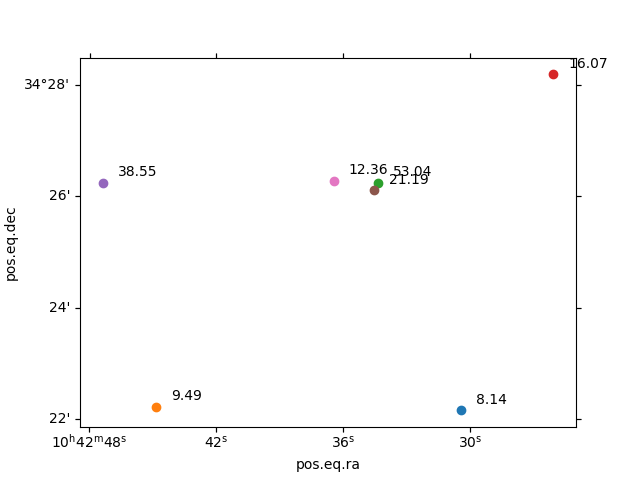

In [445]:
diff_file = '/Users/astqx/Desktop/DREAMS/test/pipeline/test4/wirc/night/diffs/image0092_stack.resamp.diff.fits'
# diff_file = '/Users/astqx/Desktop/DREAMS/test/pipeline/test3/wirc/night/diffs/ZTF21aagppzg_J_stack_1_20210330.resamp.diff.fits'

imsub_out = Fits(diff_file)
# img = imsub_out.image(wcs=True,scale=False)
# img.set_alpha(0)
# ax = imsub_out.image(wcs=True)
fig, ax = imsub_out.wcs_plot()

# fig = plt.figure(clear=True)
# ax = plt.subplot(projection='fk5')
# fig.add_axes(ax)
ras = df['ra']
decs = df['dec']
scorr = df['scorr']
text_pad_x = -0.003
text_pad_y = 0.002
# coords = [SkyCoord(ra, dec, unit='deg', frame='fk5') for ra,dec in zip(ras,decs)]
for ra,dec,lab in zip(ras,decs,scorr):
    ax.scatter(ra,dec,transform=ax.get_transform('fk5'))
    ax.text(ra+text_pad_x,dec+text_pad_y,f"{lab:.2f}",transform=ax.get_transform('fk5'))
plt.savefig(diff_file.replace('.fits','.scorr.png'),dpi=600)


In [19]:

df.sort_values('scorr',inplace=True,ascending=False)
ras = df['ra']
decs = df['dec']
scorr = df['scorr']

number = df['NUMBER']
chipsf = df['chipsf'] - # check for detection?

magpsf = df['magpsf']
sigmapsf = df['sigmapsf']

magap = df['magap']
sigmagap = df['sigmagap']

magapbig = none_mask(df['magapbig'].astype(float))
sigmagapbig = none_mask(df['sigmagapbig'].astype(float))

maglim = df['MAGLIM'][0]

fig, ax = plt.subplots()

ax.axhline(maglim,color='k',linestyle='--')

x = np.arange(1,len(number)+1,1)
ax.errorbar(x=x,y=magpsf,yerr=sigmapsf,fmt='o',capsize=5,label='PSF Photometry')
ax.errorbar(x=x,y=magap,yerr=sigmagap,fmt='o',capsize=5,label='Aperture Photometry (16)')
ax.errorbar(x=x,y=magapbig,yerr=sigmagapbig,fmt='o',capsize=5,label='Aperture Photometry (70)')

text_x = x
# text_y = [np.nanmedian([magpsf[i],magap[i],magapbig[i]]) for i in range(len(magpsf))]
text_y = np.repeat(maglim,len(number))
text_pad_x = 0.2
text_pad_y = -0.2
for num,x,y,lab,ra,dec in zip(number,text_x,text_y,scorr,ras,decs):
    txt = ax.text(x+text_pad_x,y+text_pad_y,f"{lab:.2f} ({ra:.3f}, {dec:.3f})",rotation=90)
    txt.set_clip_on(False)
ax.legend(loc='upper right')
ax.set_title('Photometry with default pipeline and reduced test data')
# ax.set_title('Photometry with default pipeline and given test data')
ax.set_xlabel('Detection number')
ax.set_ylabel('Magnitude (AB)')
ax.set_xlim([0.5,len(number)+0.5])

# text_objs=[]
# for child in ax.gca().get_children():
#     if isinstance(child, mpl.text.Text):
#         text_objs.append(child)
# display(text_objs)

extra = True
if extra:
    # non_edge = [1,3,5]
    non_edge = [1]
    vspan_width = 0.15
    for ne in non_edge:
        ax.axvspan(ne-vspan_width,ne+vspan_width,alpha=0.2)
    
ax.invert_yaxis()
# fig.tight_layout()
# fig.subplots_adjust(right=0.9)
plt.savefig(candid_pkl.replace('pkl','png'),dpi=600)

SyntaxError: invalid syntax (3347277244.py, line 7)

In [308]:
text_objs=[]
for child in plt.gca().get_children():
    if isinstance(child, mpl.text.Text):
        text_objs.append(child)
text_objs[0]

Text(1.2, 20.131200794512047, '8.14')
Text(2.2, 19.616374459279136, '9.49')
Text(3.2, 17.638010838682153, '53.04')
Text(4.2, 19.97363692438123, '16.07')
Text(6.2, 18.36487219882283, '38.55')
Text(7.2, 18.295246091111107, '21.19')
Text(8.2, 18.815539454899717, '12.36')
Text(0.5, 1.0, 'Photometry with default pipeline and reduced test data')
Text(0.0, 1.0, '')
Text(1.0, 1.0, '')


# Pipeline individual

## Load

In [ ]:
raw_sci = Fits('/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/raw/image0092.fits')
raw_sci.image()
print(raw_sci.header[0])

In [ ]:
# pipeline.set_configuration("test") 
pipeline.reduce_images(Dataset([ImageBatch()]), catch_all_errors=False, selected_configurations="test")

## Log

In [ ]:
run('log')

## Masking

In [ ]:
mask_map = Fits('/Users/astqx/Desktop/DREAMS/mirar/mirar/pipelines/wirc/wirc_files/files/wirc_bad_feb_2018.fits')
mask_map.image()

In [ ]:
run('masking')

## Dark calibration

In [ ]:
dark_test = Fits('/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/cals/test_dark.fits')
dark_test.image(scale=False)
display(dark_test.header[0])

In [ ]:
run('dark_calibration')

In [ ]:
dark_test = Fits('/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/output_steps/wirc/20210330/calibration/dark_80896b7bd9541ab00aef4c43ad1c8decc9d17088.fits')
dark_test.image()
display(dark_test.header[0])

## Header Annotator

In [ ]:
run('header_annotator')

In [ ]:
dark_calib_raw = Fits('/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/output_steps/wirc/20210330/darkcal/image0094.fits')
dark_calib_raw.image(scale=False)

## Sky-Flat calibration 

In [ ]:
run('skyflat_calibration')

In [ ]:
flat_master = Fits('/Users/astqx/Desktop/DREAMS/trash/flat_e520ad31f45b450e57bad40032eed3084edb2a10.fits')
flat_master.image(scale=False)
flat_master.header[0]

## Test files

In [ ]:
test_flat = Fits('/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/cals/test_flat.fits')
test_flat.image(scale=False)
test_flat.header[0]

In [ ]:
test_sky = Fits('/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/cals/test_sky.fits')
test_sky.image(scale=False)
test_sky.header[0]

In [ ]:
test_dark = Fits('/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/cals/test_dark.fits')
test_dark.image(scale=False)
test_dark.header[0]

# FITS

## Components

In [ ]:
file = '/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/output/wirc/20210330/subtract/ZTF21aagppzg_J_stack_1_20210330.psfmodel'
open_file = fits.open(file)
open_file.info()
data = open_file[0].data.astype(float)
print(open_file[0].header)
open_file.close()

In [ ]:
plt.figure()
# plt.title('J Band Stack (ref)')
plt.xlabel('x pixel')
plt.ylabel('y pixel')
img = np.median(data, axis=1)
# scale_low, scale_high = np.percentile(img, [5,95])
im = plt.imshow(data,cmap='magma')
# im = plt.imshow(data,cmap='magma',vmin=scale_low,vmax=scale_high)
plt.colorbar(im,fraction=0.020, pad=0.04)
plt.savefig('test-calib-flat.png',dpi=600)
plt.show()

In [ ]:
sub_psf_model = Fits('/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/output/wirc/20210330/subtract/ZTF21aagppzg_J_stack_1_20210330.psfmodel')
sub_psf_model.image(save=True)

In [ ]:
sourcetable = Fits('/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/output/wirc/20210330/sourcetable/ZTF21aagppzg_J_stack_1_20210330.fits')
sourcetable.image()

In [ ]:
sex_cat = Fits('/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/output/wirc/20210330/final_sextractor/image0092_stack.cat')
sex_cat.read(1)
print(sex_cat.data[1].columns)
sex_cat.read(2)
print(sex_cat.data[2].columns)

In [ ]:
print(sex_cat.data[2]['ELONGATION'])
sex_cat.image(hdu=2,column='ELONGATION')

In [ ]:
final = Fits('/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/final/image0092_stack.fits')
final.image(scale=False,save=True)

In [ ]:
astro = Fits('/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/autoastrometry/image0092.fits')
astro.image(scale=False,save=True)

In [ ]:
im = Fits('/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/final/image0092_stack.fits')
# im.image(scale=False,save=True)
im.header[0]

In [ ]:
raw_dir = '/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/raw'
raw_images = os.listdir(raw_dir)
for img in raw_images:
    im = Fits(os.path.join(raw_dir,img))
    im.image()
    display(im.header[0])

In [ ]:
os.system('export LIBRARY_PATH=/opt/homebrew/lib\nexport CC=cc\npip install --no-deps pyregion')

# ViSeR

In [11]:
from astroquery.vizier import Vizier

In [17]:
# catalog_vizier_code = "II/349"
# abbreviation = "ps1"
catalog_name = "2MASS"
catalog_vizier_code = "II/246"
abbreviation = "tm"
ra_key = "RAJ2000"
dec_key = "DEJ2000"
catalog_list = Vizier.find_catalogs(f"{catalog_name} {catalog_vizier_code}",max_catalogs=10000)
{k:v.description for k,v in catalog_list.items()}

{'II/246': '2MASS All-Sky Catalog of Point Sources (Cutri+ 2003)'}

In [28]:
catalogs = Vizier.get_catalogs(catalog_list.keys())
display(catalogs)

TableList with 1 tables:
	'0:II/349/ps1' with 35 column(s) and 50 row(s) 

In [11]:
ps1 = PS1(search_radius_arcmin=0.5, min_mag=100, max_mag=-100, filter_name='g')
ps1.check_coverage(ra_deg=160.63, dec_deg=34.37)
ps1.get_catalog(ra_deg=160.63, dec_deg=34.37)

<Table length=0>
<No columns>

# XMatch test

In [5]:
import mirar.catalog.vizier.base_vizier_catalog as base_vizier_catalog
from mirar.catalog.vizier.base_vizier_catalog import VizierCatalog, BaseVizierXMatch
from mirar.catalog.vizier import PS1
_ = importlib.reload(base_vizier_catalog)

No raw data directory specified. Run 'export RAW_DATA_DIR=/path/to/data' to set. The raw data directory will need to be specified manually for path function.The raw directory is being set to /Users/astqx.
No output data directory specified. Run 'export OUTPUT_DATA_DIR=/path/to/data' to set this. The output directory is being set to /Users/astqx.


In [21]:
# importlib.reload(mirar)

class PS1XMatch(BaseVizierXMatch,PS1):
    
    catalog_name = "PS1_DR1"

    projection = {
        "objID": 1,
        PS1.ra_key: 1,
        PS1.dec_key: 1,
        "gmag": 1, # try using base_vizier_catalog function get_mag_key
        "rmag": 1,
        "imag": 1,
        "zmag": 1,
    }

    column_names = {
        "objID": "psobjectid",
        PS1.ra_key: "psra",
        PS1.dec_key: "psdec",
        "gmag": "sgmag",
        "rmag": "srmag",
        "imag": "simag",
        "zmag": "szmag",
    }

    column_dtypes = {
        "psobjectid": float,
        "psra": float,
        "psdec": float,
        "sgmag": float,
        "srmag": float,
        "simag": float,
        "szmag": float,
    }   

bxmatch = PS1XMatch(search_radius_arcmin=0.5, min_mag=0, max_mag=100, filter_name='g',columns = list(PS1XMatch.column_names.keys()))
test_coords = {
    "160.6267": [160.6267,34.3694]
}
query_results = bxmatch.query(test_coords)

NameError: name 'TMASS' is not defined

In [24]:
class TMASS(BaseVizierXMatch):
    
    catalog_name = "2MASS_PSC"
    catalog_vizier_code = "II/246"
    abbreviation = "tm"
    
    ra_key = "RAJ2000"
    dec_key = "DEJ2000"

    projection = {
        "_2MASS": 0,
        "_2MASS": 1,
        ra_key: 1,
        dec_key: 1,
        "Jmag": 1,
        "e_Jmag": 1,
        "Hmag": 1,
        "e_Hmag": 1,
        "Kmag": 1,
        "e_Kmag": 1,
        "Qflg": 1,
    }

    column_names = {
        ra_key: "tmra",
        dec_key: "tmdec",
        "Jmag": "tmjmag",
        "Hmag": "tmhmag",
        "Kmag": "tmkmag",
        "e_Jmag": "tmjmagerr",
        "e_Hmag": "tmhmagerr",
        "e_Kmag": "tmkmagerr",
        "_2MASS": "tmobjectid",
        "Qflg": "tmph_qual",
    }

    column_dtypes = {
        "tmra": float,
        "tmdec": float,
        "tmjmag": float,
        "tmhmag": float,
        "tmkmag": float,
        "tmjmagerr": float,
        "tmhmagerr": float,
        "tmkmagerr": float,
        "tmobjectid": str,
        "tmph_qual": str,
    }

bxmatch = TMASS(search_radius_arcmin=0.9, min_mag=0, max_mag=100, filter_name='J',columns=list(TMASS.column_names.keys()))
test_coords = {
    "160.6267": [160.6267,34.3694]
}
query_results = bxmatch.query(test_coords)

In [25]:
query_results['160.6267'].info()

<Table length=1>
  name   dtype  unit  format                   description                  
------- ------- ---- -------- ----------------------------------------------
RAJ2000 float64  deg {:10.6f}                   (ra) Right ascension (J2000)
DEJ2000 float64  deg {:10.6f}                (dec) Declination (J2000) (dec)
 _2MASS   str17                         (designation) Source designation (1)
   Jmag float32  mag  {:6.3f}        ?(j_m) J selected default magnitude (2)
 e_Jmag float32  mag  {:6.3f} ?(j_msigcom) J total magnitude uncertainty (4)
   Hmag float32  mag  {:6.3f}        ?(h_m) H selected default magnitude (2)
 e_Hmag float32  mag  {:6.3f} ?(h_msigcom) H total magnitude uncertainty (4)
   Kmag float32  mag  {:6.3f}        ?(k_m) K selected default magnitude (2)
 e_Kmag float32  mag  {:6.3f} ?(k_msigcom) K total magnitude uncertainty (4)
   Qflg    str3                   (ph_qual) JHK Photometric quality flag (5)


In [16]:
print(list(PS1XMatch.column_names.keys()))

['objID', 'RAJ2000', 'DEJ2000', 'gmag', 'rmag', 'imag', 'zmag']


In [12]:
candid_path = '/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/vizier/ZTF21aagppzg_J_stack_1_20210330.resamp.diff_sources.pkl'
with open(candid_path,'rb') as file:
    data = pickle.load(file)
print(data.get_data())

   NUMBER  FLUX_APER  FLUXERR_APER   FLUX_AUTO  FLUXERR_AUTO  FLUX_RADIUS  \
0       1   0.844406      2.265321   70.266762     21.055063     4.283644   
1       4  -2.823674      2.292251   -2.801173     19.932997     0.483321   
2       5   4.818835      2.272585   67.076416     24.803080     4.025466   
3       6  16.375877      2.293577  475.405670     24.377316     4.205836   
4       7  18.102051      2.268275  777.957397     34.170345     5.307029   

    FLUX_MAX     X_IMAGE      Y_IMAGE  XPEAK_IMAGE  ...  srmag11 simag11  \
0   4.569578  942.061890    82.357483          942  ...     None    None   
1  11.404209  141.138702    96.667633          142  ...     None    None   
2   7.782290  222.910034    96.489937          223  ...     None    None   
3  15.430056   99.282616  1065.374146          101  ...     None    None   
4   9.169999  746.797607  1067.220825          747  ...     None    None   

  szmag11          psobjectid12      psra12    psdec12  sgmag12  srmag12  \
0   

In [6]:
from mirar.database.engine import get_engine

In [7]:
engine = get_engine(db_name='wirc')
engine.connect()

OperationalError: (psycopg.OperationalError) connection failed: FATAL:  role "None" does not exist
(Background on this error at: https://sqlalche.me/e/20/e3q8)

In [8]:
candid_path = '/Users/astqx/Desktop/DREAMS/mirar_starterpack/wirc/20210330/candidates/ZTF21aagppzg_J_stack_1_20210330.resamp.diff_sources.pkl'
with open(candid_path,'rb') as file:
    data = pickle.load(file)
display(data.get_data())

No raw data directory specified. Run 'export RAW_DATA_DIR=/path/to/data' to set. The raw data directory will need to be specified manually for path function.The raw directory is being set to /Users/astqx.
No output data directory specified. Run 'export OUTPUT_DATA_DIR=/path/to/data' to set this. The output directory is being set to /Users/astqx.


,NUMBER,FLUX_APER,FLUXERR_APER,FLUX_AUTO,FLUXERR_AUTO,FLUX_RADIUS,FLUX_MAX,X_IMAGE,Y_IMAGE,XPEAK_IMAGE,...,psdec12,psobjectid12,sgmag12,srmag12,simag12,szmag12,xmatch,objectid,prv_candidates,candid
0,1,0.844406,2.265321,70.266762,21.055063,4.283644,4.569578,942.061890,82.357483,942,...,None,None,None,None,None,None,[{'objectid': 'WIRC21aaaaa'}],WIRC21aaaaa,[],6
1,4,-2.823674,2.292251,-2.801173,19.932997,0.483321,11.404209,141.138702,96.667633,142,...,None,None,None,None,None,None,[{'objectid': 'WIRC21aaaab'}],WIRC21aaaab,[],7
2,5,4.818835,2.272585,67.076416,24.803080,4.025466,7.782290,222.910034,96.489937,223,...,None,None,None,None,None,None,[{'objectid': 'WIRC21aaaac'}],WIRC21aaaac,[],8
3,6,16.375877,2.293577,475.405670,24.377316,4.205836,15.430056,99.282616,1065.374146,101,...,34.444499,149331606931633984.0,21.5562,21.0625,21.727,None,[{'objectid': 'WIRC21aaaad'}],WIRC21aaaad,[],9
4,7,18.102051,2.268275,777.957397,34.170345,5.307029,9.169999,746.797607,1067.220825,747,...,None,None,None,None,None,None,[{'objectid': 'WIRC21aaaae'}],WIRC21aaaae,[],10


In [7]:
coords = Convert(ra = 160.626684, dec = 34.437315).get_coords()
print(coords.ra.hms)
print(coords.dec.dms)

hms_tuple(h=10.0, m=42.0, s=30.404160000010023)
dms_tuple(d=34.0, m=26.0, s=14.333999999993239)


In [42]:
sex_cat = Fits('/Users/astqx/Desktop/DREAMS/test/pipeline/test1/wirc/night/final_sextractor/image0092_stack.cat')
sex_cat.read(2)
sex_cat.data[2]
# sex_cat.header[2]

Filename: /Users/astqx/Desktop/DREAMS/test/pipeline/test1/wirc/night/final_sextractor/image0092_stack.cat
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU       4   ()      
  1  LDAC_IMHEAD    1 BinTableHDU     12   1R x 1C   [33360A]   
  2  LDAC_OBJECTS    1 BinTableHDU    113   226R x 27C   [1D, 1D, 1E, 1E, 1E, 1E, 1D, 1D, 1E, 1E, 1E, 1E, 1E, 1E, 1E, 1E, 1E, 1E, 1I, 1E, 1E, 5E, 5E, 5E, 5E, 1681E, 1E]   
HDU 0 is not float
HDU 2 is not float


FITS_rec([(160.58475718, 34.32434019, 1387.5452  ,   21.209698 ,  2.3899844, 0.5815872 , 1387.44329427,   22.20538481, 0.18273984, 0.18155219,  1.9904208 , 4.9974024e-04,  7.2340794 , 4.39367725e+03,  581.51227,   586.6695  ,  -9.10707  , 0.14373435,  1, -2.65529394e+00, 9.38592017e-01, [ 2.92171045e+03,  4.66818457e+03,  3.61951050e+03,  2.97046509e+03,  0.00000000e+00], [ 287.17484,  508.21906,  703.8623 ,  880.99384,    0.     ], [ -8.664093 ,  -9.17287  ,  -8.896625 ,  -8.682061 ,   0.       ], [1.06742904e-01, 1.18231378e-01, 2.11187243e-01, 3.22090745e-01, 0.00000000e+00], [[-1.00000002e+30, -1.00000002e+30, -1.00000002e+30, ..., -1.00000002e+30, -1.00000002e+30, -1.00000002e+30], [-1.00000002e+30, -1.00000002e+30, -1.00000002e+30, ..., -1.00000002e+30, -1.00000002e+30, -1.00000002e+30], [-1.00000002e+30, -1.00000002e+30, -1.00000002e+30, ..., -1.00000002e+30, -1.00000002e+30, -1.00000002e+30], ..., [ 3.77903175e+01,  2.97394161e+01,  1.26159649e+01, ..., -9.67362595e+01,  7.8498

Filename: /Users/astqx/Desktop/DREAMS/test/pipeline/test1/wirc/night/stack/ZTF21aagppzg_J_stack_1_20210330.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     144   (2277, 2281)   float32   


<WCSAxes: title={'center': 'stack/ZTF21aagppzg_J_stack_1_20210330.fits'}>

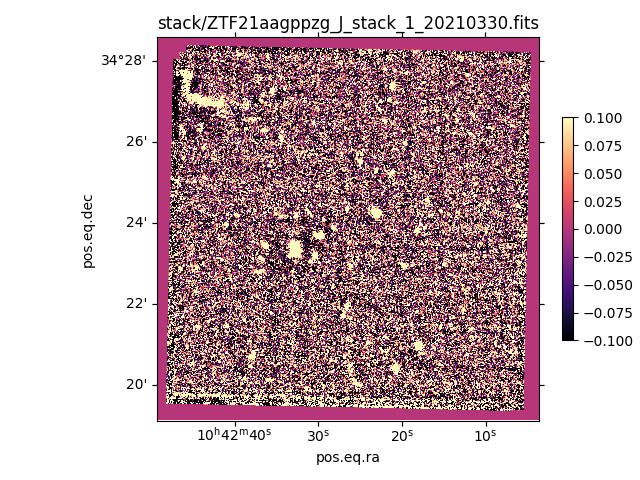

In [60]:
st = Fits('/Users/astqx/Desktop/DREAMS/test/pipeline/test1/wirc/night/stack/ZTF21aagppzg_J_stack_1_20210330.fits')
st.image(save=True,scale=[5,95],tag='scaled_wcs',wcs=True)

# Simulation test

Filename: /Users/astqx/Desktop/DREAMS/test/simulation/files/test0.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU       6   (150, 150)   float64   


<Axes: title={'center': 'files/test0.fits'}, xlabel='x pixel', ylabel='y pixel'>

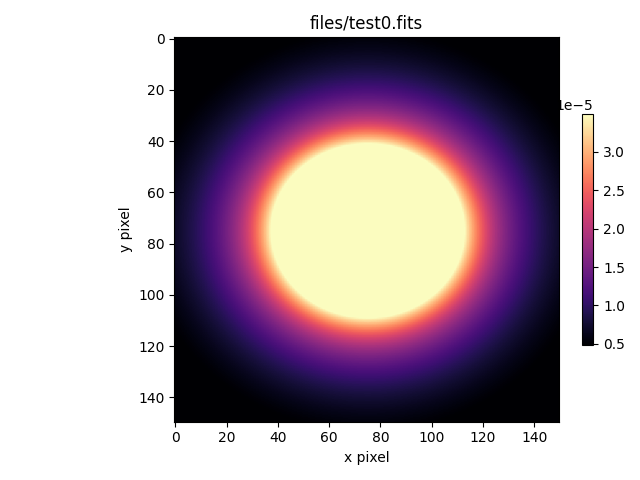

In [18]:
sim = Fits('/Users/astqx/Desktop/DREAMS/test/simulation/files/test0.fits')
sim.image()

# .cat files

In [14]:
cat = Fits('/Users/astqx/Desktop/DREAMS/test/pipeline/test4/wirc/night/phot/image0092_stack.tmass.cat')
cat.read(2)
cat.bin_table(2,save=True,return_=False)

Filename: /Users/astqx/Desktop/DREAMS/test/pipeline/test4/wirc/night/phot/image0092_stack.tmass.cat
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU       4   ()      
  1  LDAC_IMHEAD    1 BinTableHDU     12   1R x 1C   [13200A]   
  2  LDAC_OBJECTS    1 BinTableHDU    336   63R x 119C   [K, K, K, D, D, D, D, D, D, D, E, D, D, D, D, E, E, E, E, E, E, E, E, E, E, J, J, J, J, E, E, D, D, I, L, E, D, D, E, I, I, E, J, I, L, J, D, D, E, E, J, D, D, E, E, J, D, D, E, E, E, I, E, E, E, D, D, J, E, E, E, D, D, D, D, K, E, E, E, E, E, E, E, E, E, K, E, E, E, E, E, E, K, D, I, K, J, I, I, 3A, K, D, D, E, E, J, E, E, E, E, E, E, K, D, D, D, K, E, E]   


HDU 0 is not float
HDU 2 is not float


# PSF photometry

In [478]:
import numpy as np
from photutils.datasets import make_test_psf_data, make_noise_image
from photutils.psf import IntegratedGaussianPRF
psf_model = IntegratedGaussianPRF(flux=1, sigma=2.7 / 2.35)
psf_shape = (9, 9)
nsources = 10
shape = (101, 101)
data, true_params = make_test_psf_data(shape, psf_model, psf_shape,
                                       nsources, flux_range=(500, 700),
                                       min_separation=10, seed=0)
noise = make_noise_image(data.shape, mean=0, stddev=1, seed=0)
data += noise
error = np.abs(noise)

In [480]:
print(psf_model)

Model: IntegratedGaussianPRF
Inputs: ('x', 'y')
Outputs: ('z',)
Model set size: 1
Parameters:
           flux              x_0               y_0               sigma      
    ----------------- ----------------- ------------------ -----------------
    687.0144847575536 66.36807056650761 16.563974967084242 1.148936170212766


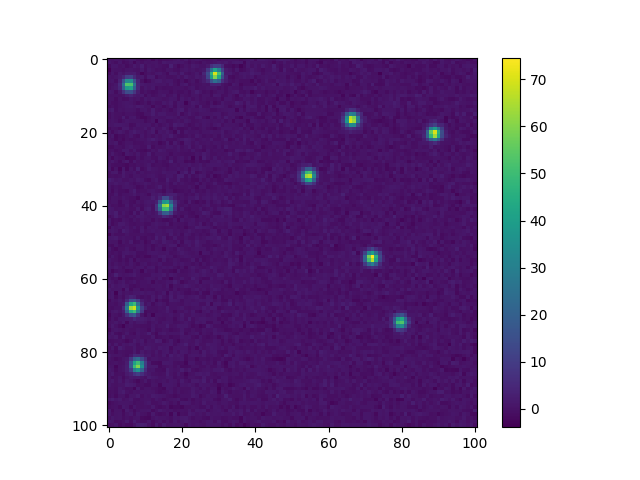

In [21]:
plt.figure()
plt.imshow(data)
plt.colorbar()
plt.show()

In [454]:
from photutils.detection import DAOStarFinder
from photutils.psf import PSFPhotometry
psf_model = IntegratedGaussianPRF(flux=1, sigma=2.7 / 2.35)
fit_shape = (5, 5)
finder = DAOStarFinder(6.0, 2.0)
psfphot = PSFPhotometry(psf_model, fit_shape, finder=finder,
                        aperture_radius=4)

<class 'photutils.psf.models.IntegratedGaussianPRF'>
Name: IntegratedGaussianPRF
N_inputs: 2
N_outputs: 1
Fittable parameters: ('flux', 'x_0', 'y_0', 'sigma')


In [455]:
psf_model

<IntegratedGaussianPRF(flux=1., x_0=0., y_0=0., sigma=1.14893617)>

In [26]:
phot = psfphot(data, error=error)
phot

id,group_id,local_bkg,x_init,y_init,flux_init,x_fit,y_fit,flux_fit,x_err,y_err,flux_err,npixfit,group_size,qfit,cfit,flags
int64,int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,int64,int64,float64,float64,int64
1,1,0.0,29.084542453331153,4.26526734347811,623.4910623338164,29.08246107570939,4.257601805190228,629.2933883639112,0.00557156218612932,0.004796077452316308,2.285349747330992,25,1,0.035719884555960243,0.0009886673890447096,0
2,2,0.0,5.4858632770142695,7.131364613868117,501.6202005211185,5.531865571918331,7.121056885130677,505.94286111994853,0.004648537128050525,0.004066940399473445,1.614293465115951,25,1,0.04231512742763711,0.0021601994304052273,0
3,3,0.0,66.38056816524139,16.530429536867274,683.920200643294,66.366680862442,16.56048555233896,687.1130320533213,0.0016049792499831423,0.0029316736922234046,0.6885025381162078,25,1,0.03171657059972666,1.5056977208016061e-05,0
4,4,0.0,88.87869500814503,20.356780521868053,664.5959067141006,88.88279510551462,20.33827677134727,662.3067819175858,0.004571903306608034,0.003847594488247379,2.1756984256971887,25,1,0.035255127768088354,-0.001410175139698419,0
5,5,0.0,54.54262641958601,31.882720630897197,613.7055066538854,54.55369932592706,31.872724326970836,621.178703160833,0.003787410636775292,0.0028610082036979725,1.0256487054094117,25,1,0.037281301988727235,0.001970693236136794,0
6,6,0.0,15.535217142254076,40.18683297378659,601.8361966778521,15.56124726332263,40.17394171591605,607.3266330332602,0.001424007425945848,0.005056475151113122,0.7962906822206588,25,1,0.035093246698383325,0.0008622970770397653,0
7,7,0.0,71.84681075591969,54.35089087982389,681.4907543494855,71.84251805423625,54.35539153316199,682.5834147968294,0.0008822395763905922,0.0005932136219219081,0.35885699666085397,25,1,0.03248067192063382,0.0014570133862583322,0
8,8,0.0,6.620287302076817,68.02204106970453,625.4573125329811,6.6282352572457555,68.02941359573238,643.45419023197,0.0053513541881964515,0.0052918524754794975,1.7694443170113914,25,1,0.035206861518543575,-0.0011357965382334059,0
9,9,0.0,79.61819378786183,71.83879682559639,507.48291419228013,79.63879642437782,71.84966868667306,505.1052215339579,0.002896698397397078,0.005053555249559773,2.217500952799909,25,1,0.04188984704399779,-0.0024144721553422256,0


In [28]:
from astropy.nddata import NDData, StdDevUncertainty
uncertainty = StdDevUncertainty(error)
nddata = NDData(data, uncertainty=uncertainty)
phot2 = psfphot(nddata)
phot2

id,group_id,local_bkg,x_init,y_init,flux_init,x_fit,y_fit,flux_fit,x_err,y_err,flux_err,npixfit,group_size,qfit,cfit,flags
int64,int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,int64,int64,float64,float64,int64
1,1,0.0,29.084542453331153,4.26526734347811,623.4910623338164,29.08246107570939,4.257601805190228,629.2933883639112,0.00557156218612932,0.004796077452316308,2.285349747330992,25,1,0.035719884555960243,0.0009886673890447096,0
2,2,0.0,5.4858632770142695,7.131364613868117,501.6202005211185,5.531865571918331,7.121056885130677,505.94286111994853,0.004648537128050525,0.004066940399473445,1.614293465115951,25,1,0.04231512742763711,0.0021601994304052273,0
3,3,0.0,66.38056816524139,16.530429536867274,683.920200643294,66.366680862442,16.56048555233896,687.1130320533213,0.0016049792499831423,0.0029316736922234046,0.6885025381162078,25,1,0.03171657059972666,1.5056977208016061e-05,0
4,4,0.0,88.87869500814503,20.356780521868053,664.5959067141006,88.88279510551462,20.33827677134727,662.3067819175858,0.004571903306608034,0.003847594488247379,2.1756984256971887,25,1,0.035255127768088354,-0.001410175139698419,0
5,5,0.0,54.54262641958601,31.882720630897197,613.7055066538854,54.55369932592706,31.872724326970836,621.178703160833,0.003787410636775292,0.0028610082036979725,1.0256487054094117,25,1,0.037281301988727235,0.001970693236136794,0
6,6,0.0,15.535217142254076,40.18683297378659,601.8361966778521,15.56124726332263,40.17394171591605,607.3266330332602,0.001424007425945848,0.005056475151113122,0.7962906822206588,25,1,0.035093246698383325,0.0008622970770397653,0
7,7,0.0,71.84681075591969,54.35089087982389,681.4907543494855,71.84251805423625,54.35539153316199,682.5834147968294,0.0008822395763905922,0.0005932136219219081,0.35885699666085397,25,1,0.03248067192063382,0.0014570133862583322,0
8,8,0.0,6.620287302076817,68.02204106970453,625.4573125329811,6.6282352572457555,68.02941359573238,643.45419023197,0.0053513541881964515,0.0052918524754794975,1.7694443170113914,25,1,0.035206861518543575,-0.0011357965382334059,0
9,9,0.0,79.61819378786183,71.83879682559639,507.48291419228013,79.63879642437782,71.84966868667306,505.1052215339579,0.002896698397397078,0.005053555249559773,2.217500952799909,25,1,0.04188984704399779,-0.0024144721553422256,0


[]

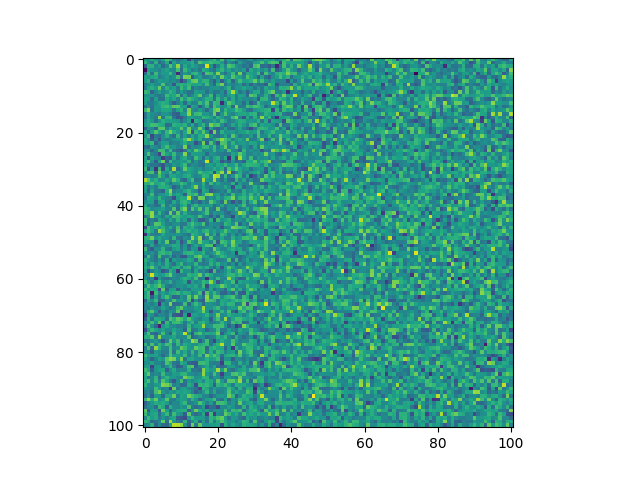

In [30]:
resid = psfphot.make_residual_image(data, (9, 9))
plt.figure()
plt.imshow(resid)
plt.plot()

In [34]:
psfphot.finder_results[0]['xcentroid'].info.format = '.4f'  # optional format
psfphot.finder_results[0]['ycentroid'].info.format = '.4f'  # optional format
psfphot.finder_results[0]['sharpness'].info.format = '.4f'  # optional format
psfphot.finder_results[0]['peak'].info.format = '.4f'
psfphot.finder_results[0]['flux'].info.format = '.4f'
psfphot.finder_results[0]['mag'].info.format = '.4f'
psfphot.finder_results[0]

id,xcentroid,ycentroid,sharpness,roundness1,roundness2,npix,sky,peak,flux,mag
int64,float64,float64,float64,float64,float64,int64,float64,float64,float64,float64
1,29.0845,4.2653,0.6018,0.013792778051490187,0.03977510047713523,25,0.0,69.7956,9.3348,-2.4253
2,5.4859,7.1314,0.5769,-0.1909731619646595,-0.10398092406690783,25,0.0,52.1110,6.9330,-2.1023
3,66.3806,16.5304,0.5964,-0.31814434209361486,0.016724233584191898,25,0.0,69.2798,8.9273,-2.3768
4,88.8787,20.3568,0.5936,-0.07904734830621699,0.027329469618075697,25,0.0,70.3036,9.2443,-2.4147
5,54.5426,31.8827,0.5937,0.05330554980858434,-0.04846018891377632,25,0.0,65.6673,8.6064,-2.3371
6,15.5352,40.1868,0.6082,-0.20917263819484871,-0.08870452302627908,25,0.0,63.6024,8.0676,-2.2669
7,71.8468,54.3509,0.6187,-0.09779030380424995,0.0590301596794863,25,0.0,74.6164,9.6917,-2.4660
8,6.6203,68.0220,0.5932,-0.08417351943840463,-0.06448379296395623,25,0.0,68.3722,8.9903,-2.3844
9,79.6182,71.8388,0.5747,0.017113969424443584,-0.060366200743054606,25,0.0,53.0129,7.0326,-2.1178


In [453]:
from photutils import psf

In [460]:
cat = Fits('/Users/astqx/Desktop/DREAMS/test/pipeline/test4/wirc/night/final_sextractor/image0092_stack.cat')
cat.read(2)
cat.bin_table(2)

Filename: /Users/astqx/Desktop/DREAMS/test/pipeline/test4/wirc/night/final_sextractor/image0092_stack.cat
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU       4   ()      
  1  LDAC_IMHEAD    1 BinTableHDU     12   1R x 1C   [33360A]   
  2  LDAC_OBJECTS    1 BinTableHDU    113   226R x 27C   [1D, 1D, 1E, 1E, 1E, 1E, 1D, 1D, 1E, 1E, 1E, 1E, 1E, 1E, 1E, 1E, 1E, 1E, 1I, 1E, 1E, 5E, 5E, 5E, 5E, 1681E, 1E]   
HDU 0 is not float
HDU 2 is not float


ValueError: Data must be 1-dimensional, got ndarray of shape (226, 5) instead

# PSF 

In [81]:
from photutils import psf

## Resampled PSF model

In [32]:
resamp_psf_model_file = '/Users/astqx/Desktop/DREAMS/test/pipeline/test4/wirc/night/subtract/image0092_stack.resamp.psfmodel'
resamp_psf_model_copy_file = '/Users/astqx/Desktop/DREAMS/test/pipeline/test4/wirc/night/subtract/image0092_stack.resamp.psfmodel.copy'
resamp_psf_file = '/Users/astqx/Desktop/DREAMS/test/pipeline/test4/wirc/night/subtract/image0092_stack_ref.resamp.psf'
wfc3_psf_model_file = '/Users/astqx/Desktop/DREAMS/test/_others/PSFSTD_WFC3UV_F225W.fits'
being_used = '/Users/astqx/Desktop/DREAMS/test/pipeline/test4/wirc/night/subtract/image0092_stack.resamp.diff.psf'
being_used_copy = '/Users/astqx/Desktop/DREAMS/test/pipeline/test4/wirc/night/subtract/image0092_stack.resamp.diff.psf.copy'

In [15]:
data = Fits(wfc3_psf_model_file)
# data.data[0][55]
data.header

Filename: /Users/astqx/Desktop/DREAMS/test/_others/PSFSTD_WFC3UV_F225W.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      35   (101, 101, 56)   float32   


 [astropy.io.fits.verify]


{0: SIMPLE  =                    T                                                  
 BITPIX  =                  -32                                                  
 NAXIS   =                    3                                                  
 NAXIS1  =                  101                                                  
 NAXIS2  =                  101                                                  
 NAXIS3  =                   56                                                  
 DATE    = '2014-01-31'                                                          
 TIME    = '09:43:41'                                                            
 BSCALE  =               1.0000                                                  
 BZERO   =               0.0000                                                  
 COMMENT                                                                         
 NXPSFS  =                    7                                                  
 NYPSFS  =   

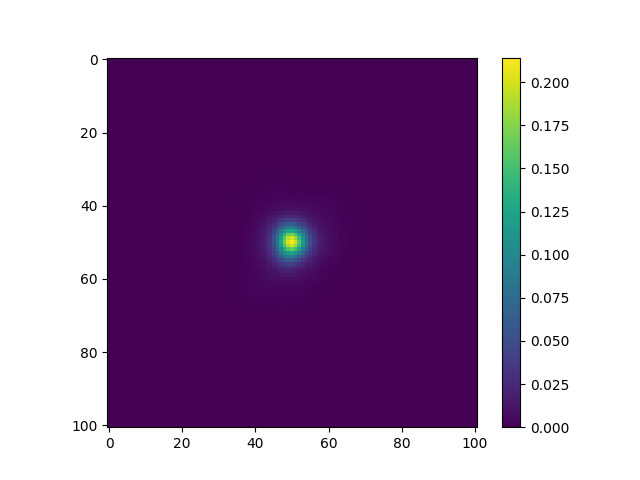

In [518]:
plt.figure()
plt.imshow(data.data[0][54])
plt.colorbar()
plt.show()

In [17]:
data = Fits(resamp_psf_file)
data.read(1)
data.data[1][0]

Filename: /Users/astqx/Desktop/DREAMS/test/pipeline/test4/wirc/night/subtract/image0092_stack_ref.resamp.psf
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU       4   ()      
  1  PSF_DATA      1 BinTableHDU     32   1R x 1C   [16810E]   
HDU 0 is not float


0.0

In [63]:
a = {
    'x': 1,
    'y': 2
}
a['x','y']

KeyError: ('x', 'y')

Filename: /Users/astqx/Desktop/DREAMS/test/pipeline/test4/wirc/night/subtract/image0092_stack.resamp.diff.psf
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      15   (41, 41)   float64   


{0: SIMPLE  =                    T                                                  
 BITPIX  =                  -64 / array data type                                
 NAXIS   =                    2 / number of array dimensions                     
 NAXIS1  =                   41                                                  
 NAXIS2  =                   41                                                  
 BASENAME= 'image0092_stack.resamp.diff.psf'                                     
 RAWPATH = '/Users/astqx/Desktop/DREAMS/test/pipeline/test4/wirc/night/subtract&'
 CONTINUE  '/image0092_stack.resamp.diff.psf'                                    
 OBSCLASS= 'science '                                                            
 TARGET  = 'ztf21aagppzg'                                                        
 DATE-OBS= '2021-03-30T08:43:42.850'                                             
 COADDS  =                    7                                                  
 GAIN    =   

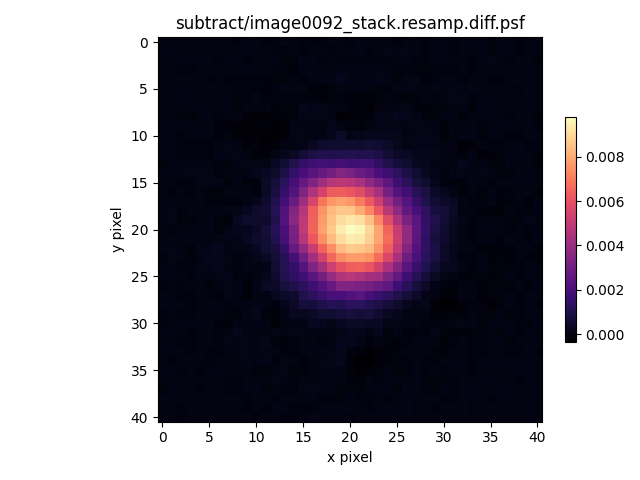

In [30]:
data = Fits(being_used)
data.image(scale=False,save=True)
data.header

In [31]:
# ! resets the result from the next block

data.create_copy()

In [100]:
# generate STDPSF from .psf file 

def generate_stdpsf_one(file,hdu=0,overwrite=True):
    fts = fits.open(file)
    data = fts[hdu].data
    header = fts[hdu].header
    fts.close()
    
    new_hdr = fits.Header()
    for key in header.keys():
        new_hdr[key] = header[key]
    
    new_hdr['NAXIS'] = 3
    new_hdr['NXPSFS'] = 1
    new_hdr['NYPSFS'] = 1
    # new_hdr['NAXIS3'] = new_hdr['NXPSFS']*new_hdr['NYPSFS'] # change data to [data] in new_hdu
    
    # new_hdr['IPSFX01'] = new_hdr['NAXIS1']//2
    new_hdr['IPSFX01'] = 0
    # new_hdr['JPSFY01'] = new_hdr['NAXIS2']//2
    new_hdr['JPSFY01'] = 0
    for i in range(2,11):
        new_hdr[f'IPSFX{i:02d}'] = 9999
        new_hdr[f'JPSFY{i:02d}'] = 9999
    
    new_hdu = fits.PrimaryHDU([data],header=new_hdr)
    new_hdul = fits.HDUList([new_hdu])
    
    new_file = f"{file}.stdpsf"
    new_hdul.writeto(new_file,overwrite=overwrite)
    
    # check copy
    new_fts = Fits(new_file)
    # if dict(header) == {key: dict(new_fts.header[hdu])[key] for key in dict(header).keys()} and (data == new_fts.data[hdu]).all():
    #     print(new_hdr['NAXIS3'])
    #     return new_fts.header[hdu]
    # else:
    #     print('copy failed')
    
    return new_fts.header[hdu]
generate_stdpsf_one(being_used_copy)
    

Filename: /Users/astqx/Desktop/DREAMS/test/pipeline/test4/wirc/night/subtract/image0092_stack.resamp.diff.psf.copy.stdpsf
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      38   (41, 41, 1)   float64   


SIMPLE  =                    T / conforms to FITS standard                      
BITPIX  =                  -64 / array data type                                
NAXIS   =                    3 / number of array dimensions                     
NAXIS1  =                   41                                                  
NAXIS2  =                   41                                                  
NAXIS3  =                    1                                                  
BASENAME= 'image0092_stack.resamp.diff.psf'                                     
RAWPATH = '/Users/astqx/Desktop/DREAMS/test/pipeline/test4/wirc/night/subtract&'
CONTINUE  '/image0092_stack.resamp.diff.psf'                                    
OBSCLASS= 'science '                                                            
TARGET  = 'ztf21aagppzg'                                                        
DATE-OBS= '2021-03-30T08:43:42.850'                                             
COADDS  =                   

In [85]:
from photutils.psf import PSFPhotometry

In [96]:
stdpsf_file = '/Users/astqx/Desktop/DREAMS/test/pipeline/test4/wirc/night/subtract/image0092_stack.resamp.diff.psf.copy.stdpsf'
psf_model = psf.stdpsf_reader(stdpsf_file)
display(psf_model)
fit_shape = (5,5)
init_params = QTable()
init_params['x'] = [20]
init_params['y'] = [20]
psfphot = PSFPhotometry(psf_model,fit_shape, aperture_radius=5)
display(Fits(stdpsf_file).data[0])
phot = psfphot(Fits(stdpsf_file).data[0][0], init_params=init_params)
display(phot)


<photutils.psf.griddedpsfmodel.GriddedPSFModel>
Grid_shape: (1, 1)
Number of ePSFs: 1
ePSF shape (oversampled pixels): (41, 41)
Oversampling: 4

Filename: /Users/astqx/Desktop/DREAMS/test/pipeline/test4/wirc/night/subtract/image0092_stack.resamp.diff.psf.copy.stdpsf
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      38   (41, 41, 1)   float64   


array([[[-4.00574287e-06, -6.12824958e-06,  6.60941913e-06, ...,
         -4.69680145e-05,  2.71657949e-06,  1.98377872e-06],
        [-1.99058988e-06,  3.86827019e-05,  1.12870648e-05, ...,
         -2.31360343e-05,  2.12630969e-06,  3.31058770e-05],
        [ 6.83347420e-06, -1.63229410e-06, -7.93159880e-06, ...,
          4.11608827e-06,  1.10868091e-05, -2.90150574e-05],
        ...,
        [ 2.89293037e-05, -1.40042344e-05,  1.12296622e-07, ...,
          9.82111533e-06, -1.36601030e-05,  1.16810201e-05],
        [ 5.83474539e-06,  8.57811162e-06, -2.05094015e-05, ...,
         -1.51612009e-05,  2.50083203e-06, -1.36251411e-05],
        [ 2.38975484e-06,  1.82444526e-05, -2.34495816e-05, ...,
         -1.34492560e-06,  1.59836266e-05, -4.02509713e-07]]])

Filename: /Users/astqx/Desktop/DREAMS/test/pipeline/test4/wirc/night/subtract/image0092_stack.resamp.diff.psf.copy.stdpsf
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      38   (41, 41, 1)   float64   


id,group_id,local_bkg,x_init,y_init,flux_init,x_fit,y_fit,flux_fit,x_err,y_err,flux_err,npixfit,group_size,qfit,cfit,flags
int64,int64,float64,int64,int64,float64,float64,float64,float64,float64,float64,float64,int64,int64,float64,float64,int64
1,1,0.0,20,20,0.5545077334860034,19.876648574971664,20.202174302543433,1.7592936414719864,nan,nan,nan,25,1,0.07662058695685783,-0.0038515894974629726,8


In [101]:
stdpsf_file = '/Users/astqx/Desktop/DREAMS/test/pipeline/test4/wirc/night/subtract/image0092_stack.resamp.diff.psf.copy.stdpsf'
psf_model = psf.stdpsf_reader(stdpsf_file)
display(psf_model)
fit_shape = (5,5)
init_params = QTable()
init_params['x'] = [20]
init_params['y'] = [20]
psfphot = PSFPhotometry(psf_model,fit_shape, aperture_radius=5)
display(Fits(stdpsf_file).data[0])
phot = psfphot(Fits(stdpsf_file).data[0][0], init_params=init_params)
display(phot)

<photutils.psf.griddedpsfmodel.GriddedPSFModel>
Grid_shape: (1, 1)
Number of ePSFs: 1
ePSF shape (oversampled pixels): (41, 41)
Oversampling: 4

Filename: /Users/astqx/Desktop/DREAMS/test/pipeline/test4/wirc/night/subtract/image0092_stack.resamp.diff.psf.copy.stdpsf
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      38   (41, 41, 1)   float64   


array([[[-4.00574287e-06, -6.12824958e-06,  6.60941913e-06, ...,
         -4.69680145e-05,  2.71657949e-06,  1.98377872e-06],
        [-1.99058988e-06,  3.86827019e-05,  1.12870648e-05, ...,
         -2.31360343e-05,  2.12630969e-06,  3.31058770e-05],
        [ 6.83347420e-06, -1.63229410e-06, -7.93159880e-06, ...,
          4.11608827e-06,  1.10868091e-05, -2.90150574e-05],
        ...,
        [ 2.89293037e-05, -1.40042344e-05,  1.12296622e-07, ...,
          9.82111533e-06, -1.36601030e-05,  1.16810201e-05],
        [ 5.83474539e-06,  8.57811162e-06, -2.05094015e-05, ...,
         -1.51612009e-05,  2.50083203e-06, -1.36251411e-05],
        [ 2.38975484e-06,  1.82444526e-05, -2.34495816e-05, ...,
         -1.34492560e-06,  1.59836266e-05, -4.02509713e-07]]])

Filename: /Users/astqx/Desktop/DREAMS/test/pipeline/test4/wirc/night/subtract/image0092_stack.resamp.diff.psf.copy.stdpsf
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      38   (41, 41, 1)   float64   


id,group_id,local_bkg,x_init,y_init,flux_init,x_fit,y_fit,flux_fit,x_err,y_err,flux_err,npixfit,group_size,qfit,cfit,flags
int64,int64,float64,int64,int64,float64,float64,float64,float64,float64,float64,float64,int64,int64,float64,float64,int64
1,1,0.0,20,20,0.5545077334860034,19.876648574971664,20.202174302543433,1.7592936414719864,nan,nan,nan,25,1,0.07662058695685783,-0.0038515894974629726,8


In [185]:
test = Fits('/Users/astqx/Desktop/DREAMS/test/pipeline/test1/wirc/night/raw/image0093.fits')
test.header[0]['OBJECT']

Filename: /Users/astqx/Desktop/DREAMS/test/pipeline/test1/wirc/night/raw/image0093.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     267   (2048, 2048)   int32   


'ZTF21aagppzg'

Filename: /Users/astqx/Desktop/DREAMS/test/pipeline/test4/wirc/night/calibration/flat_d68aa52f9419df4b8be5e5940e7932ebe243e3ee.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     298   (2048, 2048)   float64   


<Axes: title={'center': 'calibration/flat_d68aa52f9419df4b8be5e5940e7932ebe243e3ee.fits'}, xlabel='x pixel', ylabel='y pixel'>

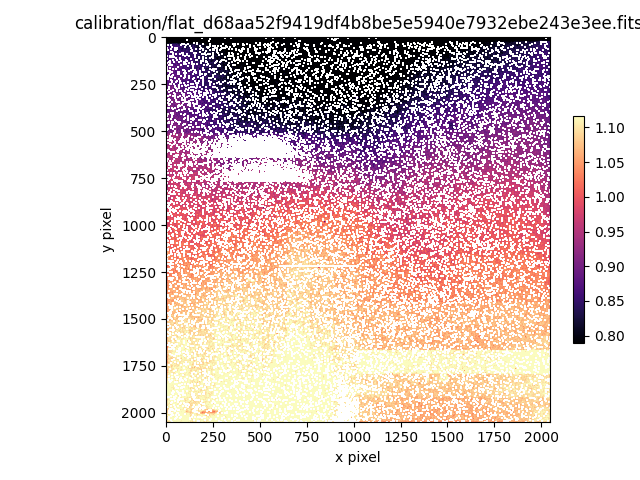

In [171]:
flat_gen_2 = Fits('/Users/astqx/Desktop/DREAMS/test/pipeline/test4/wirc/night/calibration/flat_d68aa52f9419df4b8be5e5940e7932ebe243e3ee.fits')
flat_gen_2.image()

Filename: /Users/astqx/Desktop/DREAMS/test/pipeline/test4/wirc/night/calibration/flat_e520ad31f45b450e57bad40032eed3084edb2a10.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     290   (2048, 2048)   float64   


<Axes: title={'center': 'calibration/flat_e520ad31f45b450e57bad40032eed3084edb2a10.fits'}, xlabel='x pixel', ylabel='y pixel'>

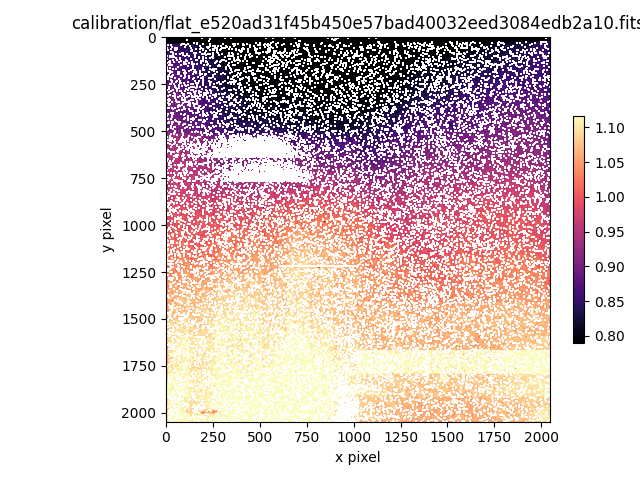

In [172]:
flat_gen_1 = Fits('/Users/astqx/Desktop/DREAMS/test/pipeline/test4/wirc/night/calibration/flat_e520ad31f45b450e57bad40032eed3084edb2a10.fits')
flat_gen_1.image()

In [158]:
flat_gen_2.scale_high

1.1170691794951724

Filename: /Users/astqx/Desktop/DREAMS/test/pipeline/test4/wirc/cals/test_flat.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     283   (2048, 2048)   float64   


<Axes: title={'center': 'cals/test_flat.fits'}, xlabel='x pixel', ylabel='y pixel'>

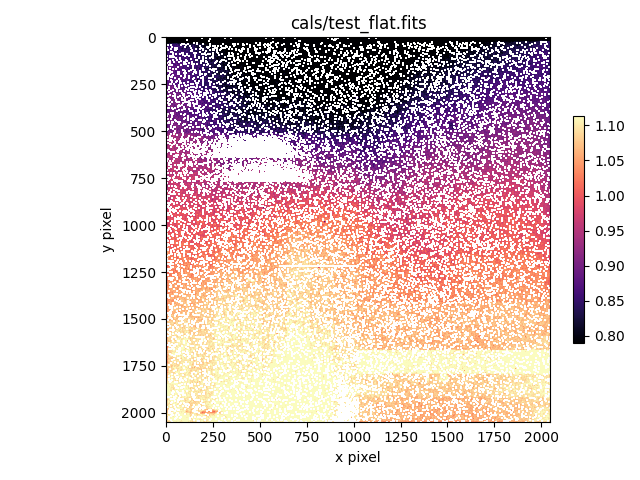

In [159]:
flat_test = Fits('/Users/astqx/Desktop/DREAMS/test/pipeline/test4/wirc/cals/test_flat.fits')
flat_test.image()

In [160]:
flat_test.scale_high

1.113858634380468

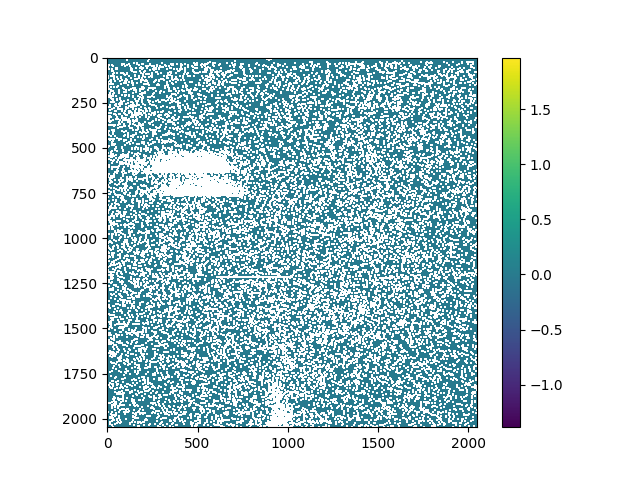

In [178]:
plt.figure(clear=True)
mask_test = np.ma.masked_where(np.logical_and(flat_test.data[0] <= flat_test.scale_high, flat_test.data[0] >= flat_test.scale_low),flat_test.data[0])
mask_gen_1 = np.ma.masked_where(np.logical_and(flat_gen_1.data[0] <= flat_gen_1.scale_high, flat_gen_1.data[0] >= flat_gen_1.scale_low),flat_gen_1.data[0])
data = np.ma.masked_where(np.ma.getmask(mask_test),flat_test.data[0]).data - np.ma.masked_where(np.ma.getmask(mask_gen_1),flat_gen_2.data[0]).data
img = np.nanmedian(data,axis=1)
scale_low, scale_high = np.percentile(img, [5,95])
plt.imshow(data)
plt.colorbar()
plt.show()

In [181]:
np.nanmean(data)

-0.0012095785476146934

Filename: /Users/astqx/Desktop/DREAMS/mirar/mirar/pipelines/wirc/wirc_files/files/wirc_bad_feb_2018.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     292   (2048, 2048)   int64   


<Axes: title={'center': 'files/wirc_bad_feb_2018.fits'}, xlabel='x pixel', ylabel='y pixel'>

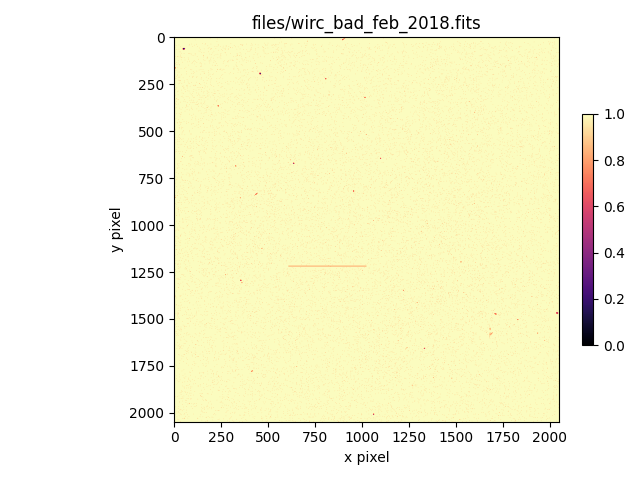

In [14]:
bad_px_map = Fits('/Users/astqx/Desktop/DREAMS/mirar/mirar/pipelines/wirc/wirc_files/files/wirc_bad_feb_2018.fits')
bad_px_map.image(scale=False)

Filename: /Users/astqx/Desktop/DREAMS/test/pipeline/test4/wirc/night/firstpasssextractor/image0092_stack_check_segmentation.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     340   (2278, 2278)   int32   


<Axes: title={'center': 'firstpasssextractor/image0092_stack_check_segmentation.fits'}, xlabel='x pixel', ylabel='y pixel'>

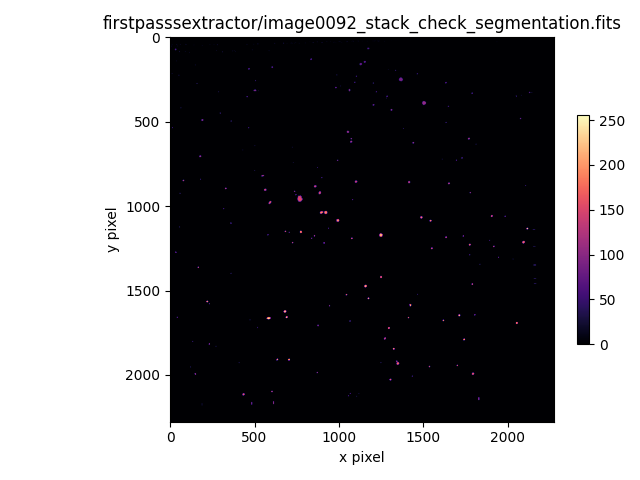

In [16]:
segmentation = Fits('/Users/astqx/Desktop/DREAMS/test/pipeline/test4/wirc/night/firstpasssextractor/image0092_stack_check_segmentation.fits')
segmentation.image(scale=False)

In [5]:
import numpy as np
import matplotlib.pyplot as plt

In [9]:
def gaussian(x, mu, sigma, amp):
    shape = 1.0 / (np.sqrt(2 * np.pi) * sigma) * np.exp(-0.5 * ((x - mu) / sigma)**2)
    return shape*amp

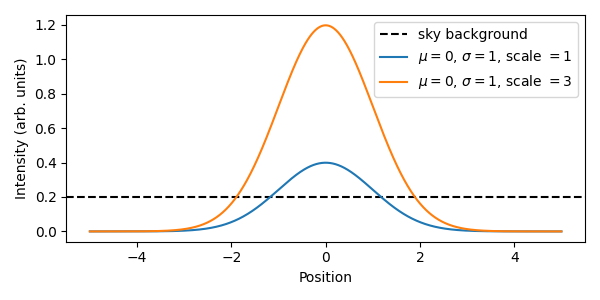

In [39]:
x = np.arange(-5,5,0.001)
gauss1 = gaussian(x,0,1,1)
gauss2 = gaussian(x,0,1,3)
fig = plt.figure(clear=True,figsize=(6,3),tight_layout=True)
plt.axhline(0.2,linestyle='--',color='k',label='sky background')
plt.plot(x,gauss1,label='$\mu=0$, $\sigma=1$, scale $= 1$')
plt.plot(x,gauss2,label='$\mu=0$, $\sigma=1$, scale $= 3$')
plt.legend(loc='upper right')
plt.ylabel('Intensity (arb. units)')
plt.xlabel('Position')
plt.savefig('/Users/astqx/Desktop/DREAMS/test/figures/psf_shape.png',dpi=600)

Filename: /Users/astqx/Desktop/DREAMS/test/pipeline/test5/wirc/night/cutouts/2023-12-25 00:26:50.705889_image0092_stack.resamp.diff.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU       6   (201, 201)   float64   


Filename: /Users/astqx/Desktop/DREAMS/test/pipeline/test5/wirc/night/cutouts/2023-12-25 00:26:53.909932_image0092_stack.resamp.diff.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU       6   (201, 201)   float64   
Filename: /Users/astqx/Desktop/DREAMS/test/pipeline/test5/wirc/night/cutouts/2023-12-25 00:26:51.296031_image0092_stack.resamp.diff.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU       6   (201, 201)   float64   
Filename: /Users/astqx/Desktop/DREAMS/test/pipeline/test5/wirc/night/cutouts/2023-12-25 00:26:49.777703_image0092_stack.resamp.diff.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU       6   (41, 41)   float64   
Filename: /Users/astqx/Desktop/DREAMS/test/pipeline/test5/wirc/night/cutouts/2023-12-25 00:26:49.215485_image0092_stack.resamp.diff.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRI

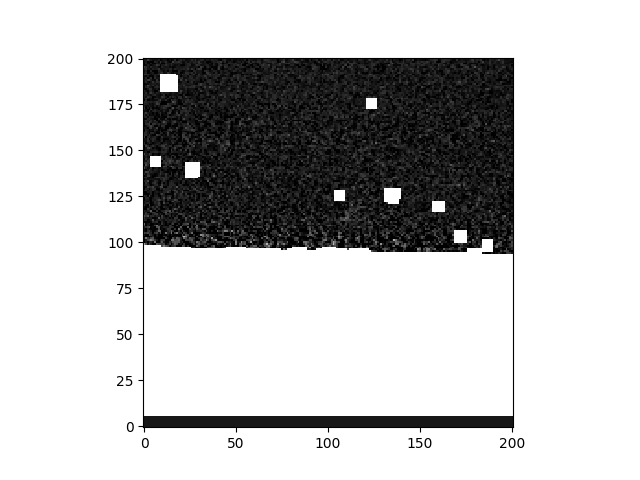

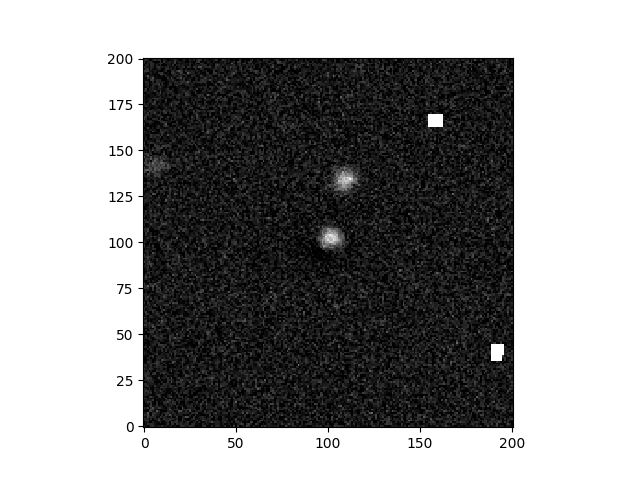

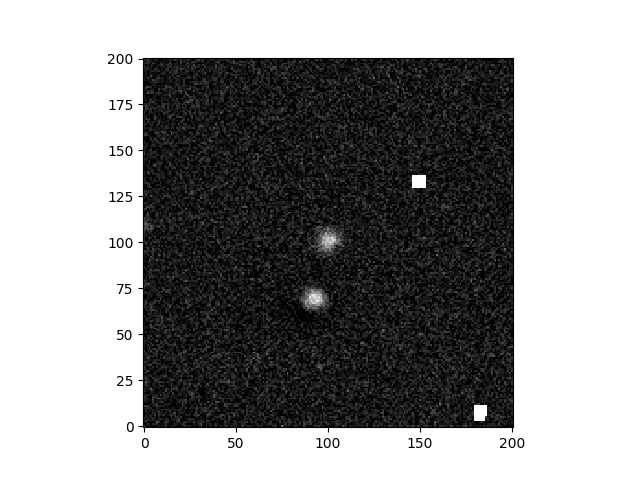

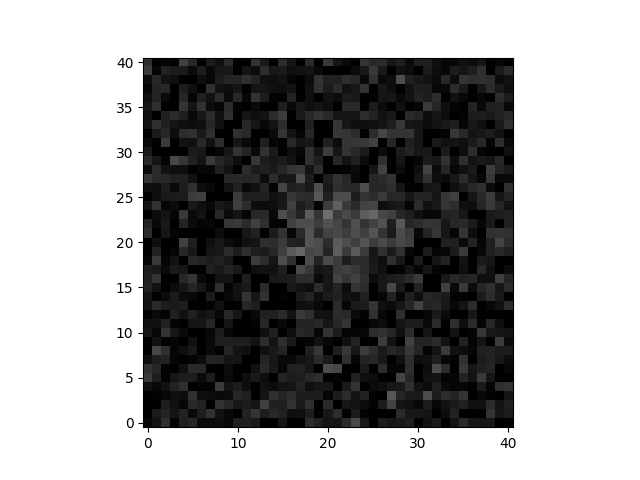

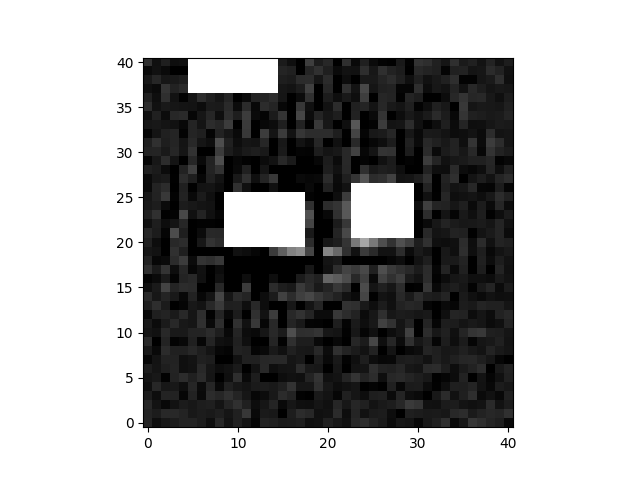

...

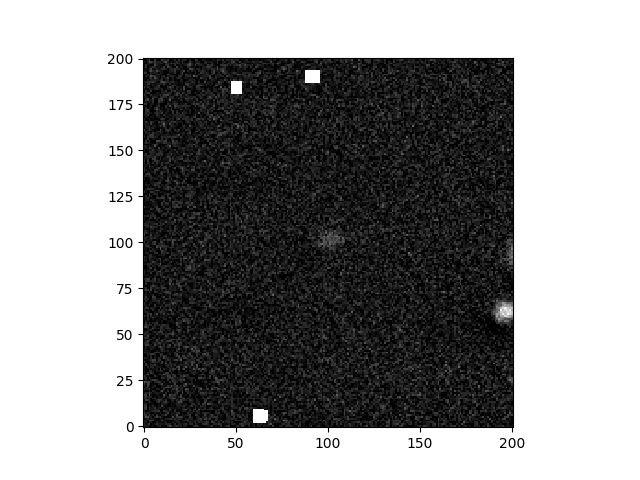

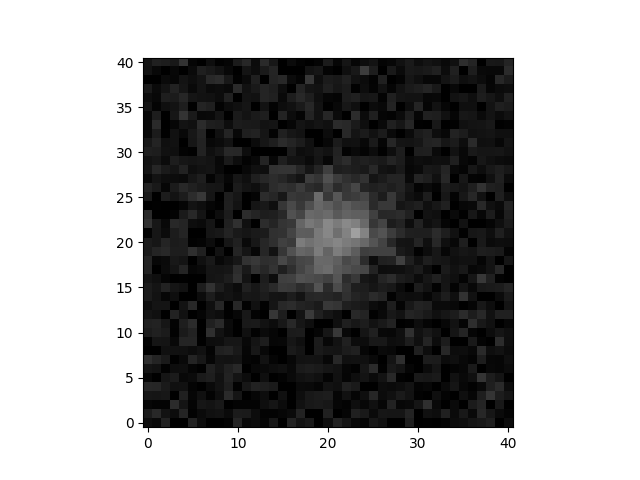

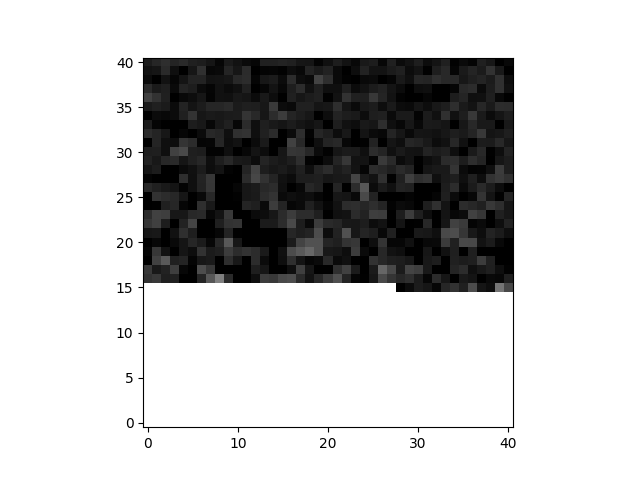

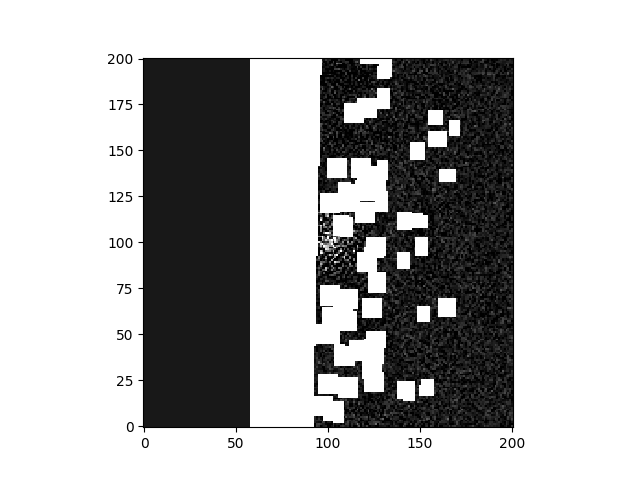

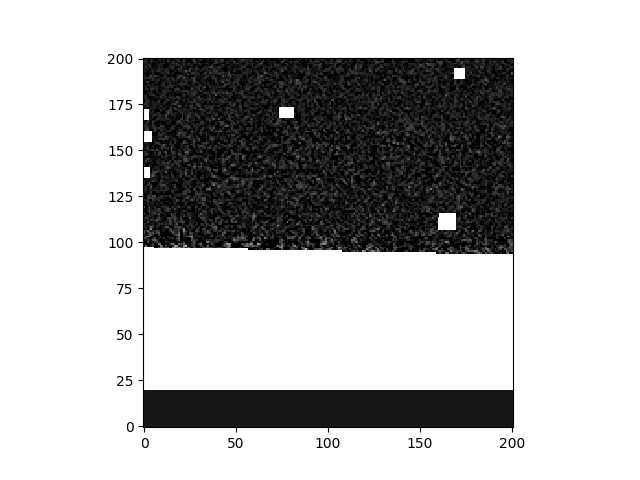

In [28]:
# cutout = Fits('/Users/astqx/Desktop/DREAMS/test/pipeline/test5/wirc/night/cutouts/2023-12-25 00:26:49.592910_image0092_stack.resamp.diff.fits')

src = '/Users/astqx/Desktop/DREAMS/test/pipeline/test5/wirc/night/cutouts/'
for file in os.listdir(src):
    if file.startswith('2023-12-25 00:26') and file.endswith('.fits'):
        filepath = os.path.join(src,file)
    else:
        continue
    cutout = Fits(filepath)
    # cutout.image(scale=False)
    fig, plot_ax = plt.subplots()
    mean, std = np.nanmean(cutout.data[0]), np.nanstd(cutout.data[0])
    plot_ax.imshow(
        cutout.data[0],
        interpolation="nearest",
        cmap="gray",
        vmin=mean - std,
        vmax=mean + 10 * std,
        origin="lower",
    )
    plt.savefig(filepath+'.png',dpi=300)

In [98]:
data = Fits('/Users/astqx/Desktop/DREAMS/test/pipeline/test5/wirc/night/diffs/image0092_stack.resamp.diff.fits')
fig, plot_ax = plt.subplots()
mean, std = np.nanmean(data.data[0]), np.nanstd(data.data[0])
img = plot_ax.imshow(
    data.data[0],
    interpolation="nearest",
    cmap="grey",
    vmin=mean - std,
    vmax=mean + 10 * std
    origin="lower",
)
fig.colorbar(img)
data.image()
# plt.savefig(filepath+'.png',dpi=300)

SyntaxError: invalid syntax. Perhaps you forgot a comma? (2344800092.py, line 9)

In [44]:
from mirar.utils import pipeline_visualisation

In [61]:
importlib.reload(pipeline_visualisation)

<module 'mirar.utils.pipeline_visualisation' from '/Users/astqx/Desktop/DREAMS/mirar/mirar/utils/pipeline_visualisation.py'>

In [48]:
test_configuration

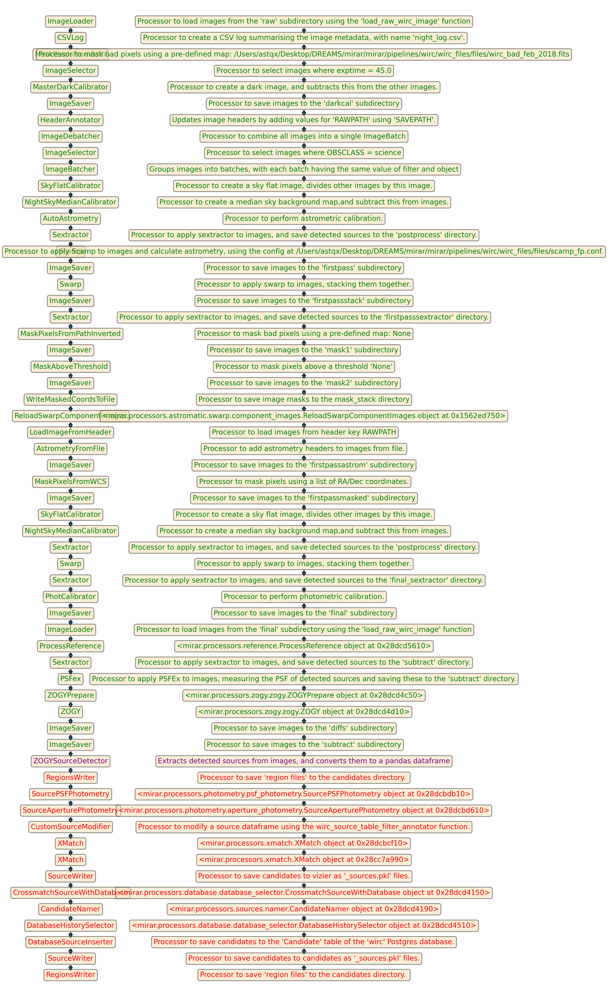

In [94]:
savepath = Path('/Users/astqx/Desktop/DREAMS/_images/wirc_flowchart.png')

ax = pipeline_visualisation.flowify(
    processor_list = test_configuration + test_imsub_reduced_configuration, 
    output_path=savepath,
    save = False
)

In [95]:
annotations = []
for child in ax.get_children():
    if isinstance(child, mpl.text.Annotation):
        annotations.append(child)

changes = {
    'MaskPixelsFromPath': False
}

for i in range(len(annotations)):
    ann_key = annotations[i].get_text()
    if ann_key in changes.keys():
        ann_val = annotations[i+1]
        ann_text = ann_val.get_text()
        if not changes[ann_key]:
            ann_text_new = ann_text.split(':')[0]
            ann_text_new += ': ' + ann_text.split(':')[1].split('mirar')[-1]
        else:
            ann_text_new = changes[ann_key]
        print(ann_text_new)
        ann_val.set_text(ann_text_new)

Processor to mask bad pixels using a pre-defined map: /pipelines/wirc/wirc_files/files/wirc_bad_feb_2018.fits


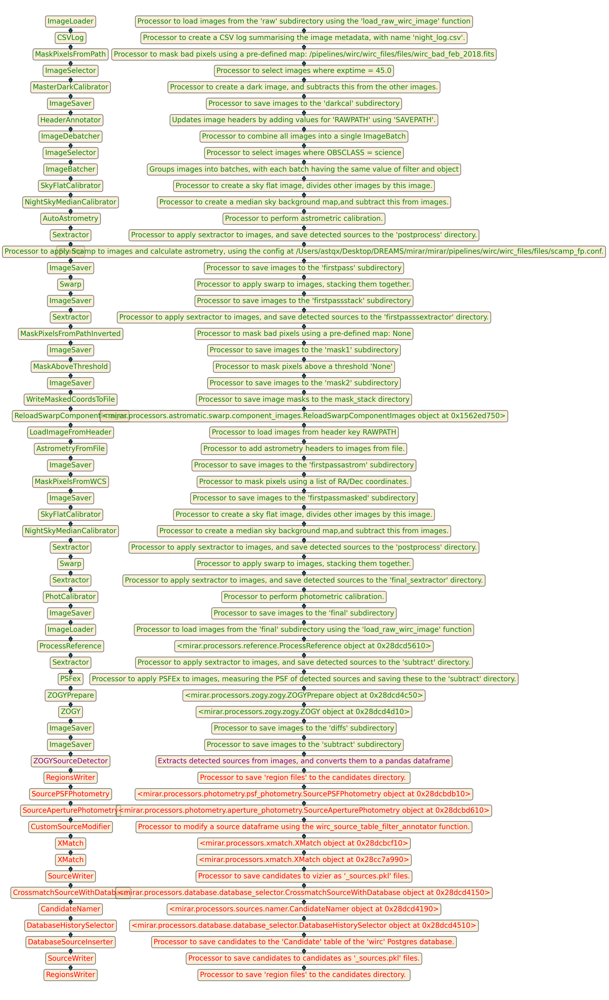

In [96]:
plt.show()